# Kernel Embedding Likelihood-Free Inference

This notebook provides a barebone no-frills implementation for Kernel Embedding Likelihood-Free Inference (KELFI) as proposed in:

Kelvin Hsu and Fabio Ramos, 2019, *Bayesian Learning of Conditional Kernel Mean Embeddings for Automatic Likelihood-Free Inference*, in Proceedings of The 22nd International Conference on Artificial Intelligence and Statistics (AISTATS 2019)

What it contains:

- Numpy implementations for the core components of KELFI: kernel means likelihood (KML), marginal kernel means likelihood (MKML), kernel means posterior (KMP), kernel means posterior embedding (KMPE), and kernel herding
- Tensorflow implementations with automatic differentiation for gradient-based hyperparameter learning through optimizing MKML
- Demonstration on the toy exponential-gamma problem using only 100 simulations to stress test the posterior approximation, compared to other surrogate-based approaches
- See Section 5.1 in the paper for a discussion on the exponential-gamma experiment

To ensure that this notebook is 100% reproducible. We have provided at the last cell of this notebook all the library package versions used in the virtual environment for running this notebook.

In [1]:
%%file kernels.py
"""
Kernel Module.

Basic functions used for computing anisotropic Gaussian kernels.

Note: Matern and other kernels were removed from this version, since they were not used in the experiments in the end.
"""
import numpy as np


def sqdist_gramix(x_p, x_q, length_scale):
    """
    Compute a gram matrix of euclidean distances between two datasets under an isotropic or anisotropic length scale.
    
    Parameters
    ----------
    x_p : np.ndarray [Size: (n_p, d)]
        A dataset
    x_q : np.ndarray [Size: (n_q, d)]
        A dataset
    length_scale : float or np.ndarray [Size: () or (1,) for isotropic; (d,) for anistropic]
        The length scale(s)
        
    Returns
    -------
    np.ndarray [Size: (n_p, n_q)]
        The resulting gram matrix
    """
    # Size: (n_p, d)
    z_p = np.atleast_2d(x_p) / length_scale
    # Size: (n_q, d)
    z_q = np.atleast_2d(x_q) / length_scale
    # Size: (n_p, n_q)
    d_pq = np.dot(z_p, z_q.transpose())
    # Size: (n_p,)
    d_p = np.sum(z_p ** 2, axis=1)
    # Size: (n_q,)
    d_q = np.sum(z_q ** 2, axis=1)
    # Size: (n_p, n_q)
    return d_p[:, np.newaxis] - 2 * d_pq + d_q


def gaussian_kernel_gramix(x_p, x_q, length_scale):
    """
    Compute a gram matrix of Gaussian kernel values between two datasets under an isotropic or anisotropic length scale.
    
    Parameters
    ----------
    x_p : np.ndarray [Size: (n_p, d)]
        A dataset
    x_q : np.ndarray [Size: (n_q, d)]
        A dataset
    length_scale : float or np.ndarray [Size: () or (1,) for isotropic; (d,) for anistropic]
        The length scale(s)
        
    Returns
    -------
    np.ndarray [Size: (n_p, n_q)]
        The resulting gram matrix
    """
    # Size: (n_p, n_q)
    return np.exp(-0.5 * sqdist_gramix(x_p, x_q, length_scale))


def convert_anisotropic(length_scale, d):
    """
    Convert isotropic length scale format to anisotropic length scale format.
    
    Parameters
    ----------
    length_scale : float or np.ndarray [Size: () or (1,) for isotropic; (d,) for anistropic]
        The length scale(s)
    d : int
        The dimensionality of the anisotropic kernel
    
    Returns
    -------
    np.ndarray [Size: (d,)]
        The anisotropic length scale(s)
    """
    # Size: (1,) or (d,)
    length_scale_array = np.atleast_1d(length_scale)
    # Make sure it is not more than 1 dimensional
    assert length_scale_array.ndim == 1
    # Make sure it is either isotropic or anisotropic
    assert length_scale_array.shape[0] in [1, d]
    # Convert it to anistropic only if it is isotropic or keep it the same
    if length_scale_array.shape[0] == 1:
        return np.repeat(length_scale_array, d)
    else:
        return length_scale_array

    
def gaussian_density_gramix(x, mu, sigma):
    """
    Compute a gram matrix of Gaussian density values of a dataset for multiple means.
    Parameters
    ----------
    x : np.ndarray [Size: (n, d)]
        A dataset
    mu : np.ndarray [Size: (m, d)]
        A dataset
    sigma : float or np.ndarray [Size: () or (1,) for isotropic; (d,) for anistropic]
        The standard deviations(s)
        
    Returns
    -------
    np.ndarray [Size: (n, m)]
        The resulting gram matrix
    """
    # Compute the scaling factor of a diagonal multivariate Gaussian distribution
    d = x.shape[-1]
    const = (np.sqrt(2 * np.pi) ** d) * np.prod(convert_anisotropic(sigma, d))
    # Size: (n, m)
    return gaussian_kernel_gramix(x, mu, sigma) / const


def gaussian_density_gramix_multiple(x, mu, sigma):
    """
    Compute the average gram matrix of Gaussian density values of a dataset for multiple arrays of means.
    
    Parameters
    ----------
    x : np.ndarray [Size: (r, n, d)]
        A dataset
    mu : np.ndarray [Size: (m, s, d)]
        A dataset where the average is to be taken over the middle dimension (s)
    sigma : float or np.ndarray [Size: () or (1,) for isotropic; (d,) for anistropic]
        The standard deviations(s)
        
    Returns
    -------
    np.ndarray [Size: (n, m)]
        The resulting gram matrix
    """    
    # Obtain and ensure the shape matches
    x = np.atleast_2d(x)
    r, n, d = x.shape
    m, s, d = mu.shape
    assert d == x.shape[-1]
    assert d == mu.shape[-1]
    # Size: (r * n, d)
    x_2d = np.reshape(x, (r * n, d))
    # Size: (m * s, d)
    mu_2d = np.reshape(mu, (m * s, d))
    # Size: (r * n, m * s)
    gramix_2d = gaussian_density_gramix(x_2d, mu_2d, sigma)
    # Size: (r, n, m, s)
    gramix_4d = np.reshape(gramix_2d, (r, n, m, s))
    # Size: (n, m)
    # return np.mean(np.prod(gramix_4d, axis=1), axis=-1)
    return np.prod(np.mean(gramix_4d, axis=-1), axis=1)

Overwriting kernels.py


In [2]:
%%file kernel_means_inference.py
"""
Kernel Means Inference Module.

Core methods for likelihood-free inference with kernel means.
"""
import numpy as np
import scipy.linalg as la
from kernels import gaussian_kernel_gramix, gaussian_density_gramix_multiple, gaussian_density_gramix, convert_anisotropic


def kernel_means_weights(y, x_sim, theta_sim, eps, beta, reg=None):
    """
    Compute the weights of the kernel means likelihood.
    
    Parameters
    ----------
    y : np.ndarray [size: (1, d)]
        Observed data or summary statistics
    x_sim : np.ndarray [size: (m, s, d)]
        Simulated data or summary statistics
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    eps : float or np.ndarray [size: () or (1,) for isotropic; (d,) for anistropic]
        The simulator noise level(s) for the epsilon-kernel or epsilon-likelihood
    beta : float or np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
    reg : float, optional
        The regularization parameter for the conditional kernel mean
        
    Returns
    -------
    np.ndarray [size: (m, 1)]
        The weights of the kernel means likelihood
    """
    # size: (m, 1)
    if x_sim.ndim == 3:
        data_epsilon_likelihood = gaussian_density_gramix_multiple(y, x_sim, eps).transpose()
    elif x_sim.ndim == 2:
        data_epsilon_likelihood = gaussian_density_gramix(y, x_sim, eps).transpose()
    else:
        raise ValueError('Simulated dataset is neither 2D or 3D.')
    
    # The number of simulations
    m = theta_sim.shape[0]
    
    # Set the regularization hyperparameter to some default value if not specified
    if reg is None:
        reg = 1e-3 * np.min(beta)
        
    # Compute the weights at O(m^3)
    theta_sim_gramix = gaussian_kernel_gramix(theta_sim, theta_sim, beta)
    lower = True
    theta_sim_gramix_cholesky = la.cholesky(theta_sim_gramix + m * reg * np.eye(m), lower=lower)
    weights = la.cho_solve((theta_sim_gramix_cholesky, lower), data_epsilon_likelihood)
    
    # size: (m, 1)
    return weights


def kernel_means_likelihood(theta_query, theta_sim, weights, beta):
    """
    Query the kernel means likelihood.
    
    Parameters
    ----------
    theta_query : np.ndarray [size: (n_query, p)]
        The parameters to query the likelihood at
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : np.ndarray [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
        
    Returns
    -------
    np.ndarray [size: (n_query,)]
        The kernel means likelihood values at the query points
    """
    # size: (m, n_query)
    theta_evaluation_gramix = gaussian_kernel_gramix(theta_sim, theta_query, beta)
    
    # size: (n_query,)
    return np.dot(theta_evaluation_gramix.transpose(), weights).ravel()


def marginal_kernel_means_likelihood(theta_sim, weights, beta, prior_mean=None, prior_std=None):
    """
    Compute the marginal kernel means likelihood under a diagonal Gaussian prior.
    
    Parameters
    ----------
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : np.ndarray [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
    prior_mean : np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The mean(s) of the diagonal Gaussian prior
    prior_std : np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The standard deviation(s) of the diagonal Gaussian prior
        
    Returns
    -------
    float
        The marginal kernel means likelihood
    """
    # By defaut, the prior has zero mean
    if prior_mean is None:
        prior_mean = np.zeros((1, theta_sim.shape[-1]))
        
    # By default, the prior standard deviation is set to the same as the length scale of the parameter kernel
    if prior_std is None:
        prior_std = beta

    # Compute the final length scale and the ratio scalar coefficient of the resulting prior mean embedding 
    prior_embedding_length_scale = np.sqrt(beta ** 2 + prior_std ** 2)
    ratio = np.prod(convert_anisotropic(beta / prior_embedding_length_scale, theta_sim.shape[1]))
        
    # Compute the prior mean embedding [size: (m, 1)]
    prior_mean_embedding = ratio * gaussian_kernel_gramix(theta_sim, np.atleast_2d(prior_mean), prior_embedding_length_scale)
    
    # Compute the kernel means marginal likelihood
    return np.dot(prior_mean_embedding.ravel(), weights.ravel())


def approximate_marginal_kernel_means_likelihood(theta_samples, theta_sim, weights, beta):
    """
    Compute the approximate marginal kernel means likelihood using prior samples.
    
    Parameters
    ----------
    theta_samples : np.ndarray [size: (n_samples, p)]
        The parameters samples to marginalize over
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : np.ndarray [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
        
    Returns
    -------
    float
        The approximate marginal kernel means likelihood
    """  
    return np.mean(kernel_means_likelihood(theta_samples, theta_sim, weights, beta))


def kernel_means_posterior(theta_query, theta_sim, weights, beta, prior_pdf, marginal_likelihood):
    """
    Query the kernel means posterior.
    
    Parameters
    ----------
    theta_query : np.ndarray [size: (n_query, p)]
        The parameters to query the likelihood at
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : np.ndarray [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
    prior_pdf : callable
        The prior probability density function
    marginal_likelihood: float
        The pre-computed marginal kernel means likelihood
        
    Returns
    -------
    np.ndarray [size: (n_query,)]
        The kernel means likelihood values at the query points
    """
    return kernel_means_likelihood(theta_query, theta_sim, weights, beta) * prior_pdf(theta_query).ravel() / marginal_likelihood
  

def kernel_means_posterior_embedding(theta_query, theta_sim, weights, beta, prior_mean=None, prior_std=None, marginal_likelihood=None):
    """
    Compute the kernel means posterior embedding.
    
    Parameters
    ----------
    theta_query : np.ndarray [size: (n_query, p)]
        The parameters to query the likelihood at
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : np.ndarray [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
    prior_mean : np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The mean(s) of the diagonal Gaussian prior
    prior_std : np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The standard deviation(s) of the diagonal Gaussian prior
    marginal_likelihood : float, optional
        The marginal likelihood value if it was precomputed
    """
    # By defaut, the prior has zero mean
    if prior_mean is None:
        prior_mean = np.zeros((1, theta_sim.shape[-1]))
        
    # By default, the prior standard deviation is set to the same as the length scale of the parameter kernel
    # Compute the final length scale of the resulting prior mean embedding
    if prior_std is None:
        prior_std = beta
        
    # Anisotropic constants
    sigma = convert_anisotropic(prior_std, theta_sim.shape[1])
    s = 1 / np.sqrt(2 / (beta ** 2) + 1 / (sigma ** 2))
    gamma = convert_anisotropic(beta / sigma, theta_sim.shape[1])
    denom = 2 + (gamma ** 2)
    
    # Broadcast: (m, d) -> (1, m, d)
    theta_sim_broad = theta_sim[np.newaxis, :, :]
    
    # Broadcast: (q, d) -> (q, 1, d)
    theta_query_broad = theta_query[:, np.newaxis, :]
    
    # Compute the quadratic term in the exponent with size: (q, m, d)
    first = theta_query_broad ** 2 + theta_sim_broad ** 2 + (gamma * prior_mean) **2
    second = theta_query_broad + theta_sim + gamma ** 2 * prior_mean
    c = first / denom - (second / denom) ** 2
    
    # Perform the integral and multiple each dimension to get size: (q, m)
    h = np.prod((s / sigma) * np.exp(- 0.5 * c / (s ** 2)), axis=-1)
    
    # Compute the marginal likelihood if it has not been computed already
    if marginal_likelihood is None:
        marginal_likelihood = kernel_means_marginal_likelihood(theta_sim, weights, beta, prior_mean=prior_mean, prior_std=prior_std)
    
    # size: (q,)
    return np.dot(h, weights).ravel() / marginal_likelihood


def approximate_kernel_means_posterior_embedding(theta_query, theta_sim, weights, beta, theta_samples, marginal_likelihood=None, beta_query=None):
    """
    Compute the approximate kernel means posterior embedding.
    
    Parameters
    ----------
    theta_query : np.ndarray [size: (n_query, p)]
        The parameters to query the likelihood at
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : np.ndarray [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
    theta_samples : np.ndarray [size: (n_samples, p)]
        The parameters samples to marginalize over
    marginal_likelihood : float, optional
        The marginal likelihood value if it was precomputed
    """
    # Approximate the integral empirically with size: (q, m)
    if beta_query is None:
        beta_query = beta
    h = np.dot(gaussian_kernel_gramix(theta_query, theta_samples, beta_query), gaussian_kernel_gramix(theta_samples, theta_sim, beta)) / theta_samples.shape[0]
    
    # Compute the marginal likelihood if it has not been computed already
    if marginal_likelihood is None:
        marginal_likelihood = approximate_marginal_kernel_means_likelihood(theta_samples, theta_sim, weights, beta)
        
    # size: (q,)
    return np.dot(h, weights).ravel() / marginal_likelihood
    
    
def kernel_herding(mean_embedding_values_or_function, kernel_function, samples, n_super_samples, init_super_samples=None):
    """
    Obtain super samples via kernel herding.
    
    Parameters
    ----------
    mean_embedding_values_or_function : callable or np.ndarray [size: (n_samples,)]
        An mean embedding function of one argument or the mean embedding values queried at the samples
    kernel_function : callable
        A kernel function of two arguments on samples
    samples : np.ndarray (n_samples, n_dim)
        The original samples to samples from
    n_super_samples : int
        The number of super samples to obtain
    init_super_samples : np.ndarray [size: (n_init_super_samples, n_dim)], optional
        The super samples already obtained if one wants to continue sampling instead of restarting the herd
    """
    # Initialize the super samples
    if init_super_samples is None:
        n_init_super_samples = 0
        super_samples = np.zeros((n_super_samples, samples.shape[1]))
    else:
        n_init_super_samples = init_super_samples.shape[0]
        super_samples[:n_init_super_samples] = init_super_samples
    
    # Obtain the mean embedding quried at the samples
    if type(mean_embedding_values_or_function) is callable:
        mu = embedding_values_or_function(samples)
    else:
        mu = mean_embedding_values_or_function
        assert mu.shape[0] == samples.shape[0]
        
    # Perform standard kernel herding
    mu_hat_sum = 0
    for i in range(n_init_super_samples, n_super_samples):
        mu_hat = mu_hat_sum / (i + 1)
        objective = mu - mu_hat
        super_samples[i] = samples[np.argmax(objective)]
        mu_hat_sum += kernel_function(super_samples[[i]], samples).ravel()

    # size : (n_super_samples, n_dim)
    return super_samples

Overwriting kernel_means_inference.py


In [3]:
%%file utils.py
"""
Utils Module.

Miscellaneous methods that are helpful.
"""
import numpy as np
import ghalton as gh

def halton_sequence(n_points=1, n_dims=1):
    """
    Generate Quasi Monte Carlo samples using the Halton sequence.
    
    Parameters
    ----------
    n_points : int
        The number of data points to generate
    n_dims : int
        The number of dimensions to generate the samples in

    Returns
    -------
    numpy.ndarray
        A dataset of size (n_points, n_dims)
    """
    sequencer = gh.Halton(n_dims)
    points = np.array(sequencer.get(n_points))
    return points

Overwriting utils.py


In [4]:
%%file tensorflow_kernels.py
"""
Kernel Module.

Basic functions used for computing anisotropic Gaussian kernels.

Note: Matern and other kernels were removed from this version, since they were not used in the experiments in the end.
"""
import tensorflow as tf
import numpy as np


def sqdist_gramix(x_p, x_q, length_scale):
    """
    Compute a gram matrix of euclidean distances between two datasets under an isotropic or anisotropic length scale.
    
    Parameters
    ----------
    x_p : tf.Tensor [Size: (n_p, d)]
        A dataset
    x_q : tf.Tensor [Size: (n_q, d)]
        A dataset
    length_scale : float or tf.Tensor [Size: () or (1,) for isotropic; (d,) for anistropic]
        The length scale(s)
        
    Returns
    -------
    tf.Tensor [Size: (n_p, n_q)]
        The resulting gram matrix
    """
    # Size: (n_p, d)
    z_p = x_p / length_scale
    # Size: (n_q, d)
    z_q = x_q / length_scale
    # Size: (n_p, n_q)
    d_pq = tf.matmul(z_p, tf.transpose(z_q))
    # Size: (n_p,)
    d_p = tf.reduce_sum(z_p ** 2, axis=1)
    # Size: (n_q,)
    d_q = tf.reduce_sum(z_q ** 2, axis=1)
    # Size: (n_p, n_q)
    return d_p[:, tf.newaxis] - 2 * d_pq + d_q


def gaussian_kernel_gramix(x_p, x_q, length_scale):
    """
    Compute a gram matrix of Gaussian kernel values between two datasets under an isotropic or anisotropic length scale.
    
    Parameters
    ----------
    x_p : tf.Tensor [Size: (n_p, d)]
        A dataset
    x_q : tf.Tensor [Size: (n_q, d)]
        A dataset
    length_scale : float or tf.Tensor [Size: () or (1,) for isotropic; (d,) for anistropic]
        The length scale(s)
        
    Returns
    -------
    tf.Tensor [Size: (n_p, n_q)]
        The resulting gram matrix
    """
    # Size: (n_p, n_q)
    return tf.exp(-0.5 * sqdist_gramix(x_p, x_q, length_scale))


def atleast_1d(tensor):
    """
    Convert a tensor to at least 1 dimensional (equivalent to np.atleast_1d).
    
    Parameters
    ----------
    tensor : tf.Tensor
        A tensor
    
    Returns
    -------
    tf.Tensor
        A tensor of at least 1 dimension
    """
    return tf.reshape(tensor, [1]) if len(tensor.get_shape()) == 0 else tensor


def atleast_2d(tensor):
    """
    Convert a tensor to at least 2 dimensional (equivalent to np.atleast_2d).
    
    Parameters
    ----------
    tensor : tf.Tensor
        A tensor
    
    Returns
    -------
    tf.Tensor
        A tensor of at least 2 dimension
    """
    return tf.reshape(tensor, [1, 1]) if len(tensor.get_shape()) == 0 else tf.reshape(tensor, [1, tensor.get_shape().as_list()[-1]])


def convert_anisotropic(length_scale, d):
    """
    Convert isotropic length scale format to anisotropic length scale format.
    
    Parameters
    ----------
    length_scale : tf.Tensor [Size: () or (1,) for isotropic; (d,) for anistropic]
        The length scale(s)
    d : int
        The dimensionality of the anisotropic kernel
    
    Returns
    -------
    tf.Tensor [Size: (d,)]
        The anisotropic length scale(s)
    """
    # Size: (1,) or (d,)
    length_scale_array = atleast_1d(length_scale)
    # Make sure it is not more than 1 dimensional
    assert len(length_scale_array.get_shape()) == 1
    # Make sure it is either isotropic or anisotropic
    assert length_scale_array.get_shape().as_list()[0] in [1, d]
    # Convert it to anistropic only if it is isotropic or keep it the same
    if length_scale_array.get_shape().as_list()[0] == 1:
        return tf.tile(length_scale_array, [d])
    else:
        return length_scale_array

    
def gaussian_density_gramix(x, mu, sigma):
    """
    Compute a gram matrix of Gaussian density values of a dataset for multiple means.
    Parameters
    ----------
    x : tf.Tensor [Size: (n, d)]
        A dataset
    mu : tf.Tensor [Size: (m, d)]
        A dataset
    sigma : float or tf.Tensor [Size: () or (1,) for isotropic; (d,) for anistropic]
        The standard deviations(s)
        
    Returns
    -------
    tf.Tensor [Size: (n, m)]
        The resulting gram matrix
    """
    # Compute the scaling factor of a diagonal multivariate Gaussian distribution
    d = mu.get_shape().as_list()[-1]
    const = (tf.sqrt(2 * np.pi) ** d) * tf.reduce_prod(convert_anisotropic(sigma, d))
    # Size: (n, m)
    return gaussian_kernel_gramix(x, mu, sigma) / const


def gaussian_density_gramix_multiple(x, mu, sigma):
    """
    Compute the average gram matrix of Gaussian density values of a dataset for multiple arrays of means.
    
    Parameters
    ----------
    x : tf.Tensor [Size: (r, n, d)]
        A dataset
    mu : tf.Tensor [Size: (m, s, d)]
        A dataset where the average is to be taken over the middle dimension (s)
    sigma : float or tf.Tensor [Size: () or (1,) for isotropic; (d,) for anistropic]
        The standard deviations(s)
        
    Returns
    -------
    tf.Tensor [Size: (n, m)]
        The resulting gram matrix
    """    
    # Obtain and ensure the shape matches
    r, n, d = tuple(x.get_shape().as_list())
    m, s, d = tuple(mu.get_shape().as_list())
    assert d == x.get_shape().as_list()[-1]
    assert d == mu.get_shape().as_list()[-1]
    # Size: (r * n, d)
    x_2d = tf.reshape(x, [r * n, d])
    # Size: (m * s, d)
    mu_2d = tf.reshape(mu, [m * s, d])
    # Size: (r * n, m * s)
    gramix_2d = gaussian_density_gramix(x_2d, mu_2d, sigma)
    # Size: (r, n, m, s)
    gramix_4d = tf.reshape(gramix_2d, [r, n, m, s])
    # Size: (n, m)
    # return tf.reduce_mean(tf.reduce_prod(gramix_4d, axis=1), axis=-1)
    return tf.reduce_prod(tf.reduce_mean(gramix_4d, axis=-1), axis=1)

Overwriting tensorflow_kernels.py


In [5]:
%%file kernel_means_learning.py
"""
Kernel Means Learning Module.

Core methods for Bayesian learning of hyperparameters for likelihood-free inference with kernel means.
"""
import numpy as np
import tensorflow as tf
from tensorflow_kernels import gaussian_kernel_gramix, gaussian_density_gramix_multiple, gaussian_density_gramix, convert_anisotropic, atleast_2d


def kernel_means_weights(y, x_sim, theta_sim, eps, beta, reg=None):
    """
    Compute the weights of the kernel means likelihood.
    
    Parameters
    ----------
    y : tf.Tensor [size: (1, d)]
        Observed data or summary statistics
    x_sim : tf.Tensor [size: (m, s, d)]
        Simulated data or summary statistics
    theta_sim : tf.Tensor [size: (m, p)]
        Parameter values corresponding to the simulations
    eps : float or tf.Tensor [size: () or (1,) for isotropic; (d,) for anistropic]
        The simulator noise level(s) for the epsilon-kernel or epsilon-likelihood
    beta : float or tf.Tensor [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
    reg : float, optional
        The regularization parameter for the conditional kernel mean
        
    Returns
    -------
    tf.Tensor [size: (m, 1)]
        The weights of the kernel means likelihood
    """
    # size: (m, 1)
    if len(x_sim.get_shape().as_list()) == 3:
        data_epsilon_likelihood = tf.transpose(gaussian_density_gramix_multiple(y, x_sim, eps))
    elif len(x_sim.get_shape().as_list()) == 2:
        data_epsilon_likelihood = tf.transpose(gaussian_density_gramix(y, x_sim, eps))
    else:
        raise ValueError('Simulated dataset is neither 2D or 3D.')
        
    # The number of simulations
    m = theta_sim.get_shape().as_list()[0]
    
    # Set the regularization hyperparameter to some default value if not specified
    if reg is None:
        reg = 1e-3 * tf.reduce_min(beta)
        
    # Compute the weights at O(m^3)
    theta_sim_gramix = gaussian_kernel_gramix(theta_sim, theta_sim, beta)
    theta_sim_gramix_cholesky = tf.cholesky(theta_sim_gramix + m * reg * tf.eye(m))
    weights = tf.cholesky_solve(theta_sim_gramix_cholesky, data_epsilon_likelihood)
    
    # size: (m, 1)
    return weights


def kernel_means_likelihood(theta_query, theta_sim, weights, beta):
    """
    Query the kernel means likelihood.
    
    Parameters
    ----------
    theta_query : tf.Tensor [size: (n_query, p)]
        The parameters to query the likelihood at
    theta_sim : tf.Tensor [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : tf.Tensor [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or tf.Tensor [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
        
    Returns
    -------
    tf.Tensor [size: (n_query,)]
        The kernel means likelihood values at the query points
    """
    # size: (m, n_query)
    theta_evaluation_gramix = gaussian_kernel_gramix(theta_sim, theta_query, beta)
    
    # size: (n_query,)
    return tf.squeeze(tf.matmul(tf.transpose(theta_evaluation_gramix), weights))


def marginal_kernel_means_likelihood(theta_sim, weights, beta, prior_mean=None, prior_std=None):
    """
    Compute the marginal kernel means likelihood under a diagonal Gaussian prior.
    
    Parameters
    ----------
    theta_sim : tf.Tensor [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : tf.Tensor [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or tf.Tensor [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
    prior_mean : tf.Tensor [size: () or (1,) for isotropic; (p,) for anistropic]
        The mean(s) of the diagonal Gaussian prior
    prior_std : tf.Tensor [size: () or (1,) for isotropic; (p,) for anistropic]
        The standard deviation(s) of the diagonal Gaussian prior
        
    Returns
    -------
    float
        The marginal kernel means likelihood
    """
    # By defaut, the prior has zero mean
    if prior_mean is None:
        prior_mean = tf.zeros((1, theta_sim.get_shape().as_list()[-1]))
        
    # By default, the prior standard deviation is set to the same as the length scale of the parameter kernel
    if prior_std is None:
        prior_std = beta

    # Compute the final length scale and the ratio scalar coefficient of the resulting prior mean embedding 
    prior_embedding_length_scale = tf.sqrt(beta ** 2 + prior_std ** 2)
    ratio = tf.reduce_prod(convert_anisotropic(beta / prior_embedding_length_scale, theta_sim.get_shape().as_list()[1]))
        
    # Compute the prior mean embedding [size: (m, 1)]
    prior_mean_embedding = ratio * gaussian_kernel_gramix(theta_sim, atleast_2d(prior_mean), prior_embedding_length_scale)
    
    # Compute the kernel means marginal likelihood
    return tf.reduce_sum(tf.multiply(prior_mean_embedding, weights))


def approximate_marginal_kernel_means_likelihood(theta_samples, theta_sim, weights, beta):
    """
    Compute the approximate marginal kernel means likelihood using prior samples.
    
    Parameters
    ----------
    theta_samples : tf.Tensor [size: (n_samples, p)]
        The prior parameter samples to marginalize over
    theta_sim : tf.Tensor [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : tf.Tensor [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or tf.Tensor [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
        
    Returns
    -------
    float
        The approximate marginal kernel means likelihood   
    """
    return tf.reduce_mean(kernel_means_likelihood(theta_samples, theta_sim, weights, beta))


def kernel_means_hyperparameter_learning(y, x_sim, theta_sim, eps_tuple, beta_tuple, reg_tuple,
                                         eps_ratios=1., beta_ratios=1., offset=0.,
                                         prior_samples=None, prior_mean=None, prior_std=None,
                                         learning_rate=0.01, n_iter=1000, display_steps=10):
    """
    Bayesian hyperparameter learning for KELFI by maximizing the MKML.
    
    The API is written to take in numpy arrays. There is no need to pass in tensorflow tensors directly.
    If the prior is Gaussian, analytical forms exist. Specify its mean and standard deviation in 'prior_mean' and 'prior_std'.
    Otherwise, approximate forms exist by using prior samples. Provide the samples via 'prior_samples'.
    If neither is provided, the prior is assumed to be Gaussian with zero mean 
    and standard deviation equal to the length scale of the parameter kernel.
    For anisotropic cases, it could be convenient to learn the multiplier on fixed length scale ratios. This is 
    especially true for the parameter kernel, where the length scales can be set to a scaled multiple of the prior
    standard deviations. Provide these ratios in 'eps_ratios' and 'beta_ratios'.
    
    Parameters
    ----------
    y : np.ndarray [size: (1, d)]
        Observed data or summary statistics
    x_sim : np.ndarray [size: (m, s, d)]
        Simulated data or summary statistics
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    eps_tuple : tuple (eps_init, learn_flag)
        eps_init: float or np.ndarray [size: () or (1,) for isotropic; (d,) for anistropic]
            The initial simulator noise level(s) for the epsilon-kernel or epsilon-likelihood
        learn_flag: str
            Indicate learning for this hyperparameter with 'learn' and use 'fix' otherwise
    beta_tuple : tuple (beta_init, learn_flag)
        beta_init: float or np.ndarray [size: () or (1,) for isotropic; (d,) for anistropic]
            The initial length scale(s) for the parameter kernel
        learn_flag: str
            Indicate learning for this hyperparameter with 'learn' and use 'fix' otherwise
    reg_tuple : tuple (reg_init, learn_flag)
        reg_init: float
            The initial regularization parameter for the conditional kernel mean
        learn_flag: str
            Indicate learning for this hyperparameter with 'learn' and use 'fix' otherwise
    eps_ratios: float or np.ndarray [size: () or (1,) for isotropic; (d,) for anistropic]
        Fixed ratios for the simulator noise level(s) for the epsilon-kernel or epsilon-likelihood
    beta_ratios: float or np.ndarray [size: () or (1,) for isotropic; (d,) for anistropic]
        Fixed ratios for the length scale(s) for the parameter kernel
    offset : float
        A positive offset in case approximate marginal kernel means likelihood values are slightly negative.
    prior_samples : np.ndarray [size: (n_samples, p)]
        The parameters samples to marginalize over
    prior_mean : np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The mean(s) of the diagonal Gaussian prior
    prior_std : np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The standard deviation(s) of the diagonal Gaussian prior
    learning_rate : float
        The learning rate for the gradient update
    n_iter : int
        Number of iterations
    display_steps : int
        Number of iterations before displaying the current optimization status
    """
    # Short notation for converting into tensorflow constants or variables
    tfc = lambda array: tf.constant(array, dtype=tf.float32)
    tfv = lambda array: tf.Variable(array, dtype=tf.float32)
    
    # Convert hyperparameters to variable for learning or constants otherwise
    log_eps = tfv(np.log(eps_tuple[0])) if eps_tuple[1] == 'learn' else tfc(np.log(eps_tuple[0]))
    log_beta = tfv(np.log(beta_tuple[0])) if beta_tuple[1] == 'learn' else tfc(np.log(beta_tuple[0]))
    log_reg = tfv(np.log(reg_tuple[0])) if reg_tuple[1] == 'learn' else tfc(np.log(reg_tuple[0]))
    
    # Transform the hyperparameters into the actual hyperparameters if not already
    eps_ = tf.exp(log_eps) * eps_ratios
    beta_ = tf.exp(log_beta) * beta_ratios
    reg_ = tf.exp(log_reg)
    
    # Convert all data into constants
    y_, x_sim_, theta_sim_ = tfc(y), tfc(x_sim), tfc(theta_sim)
    
    # Compute the weights
    weights_ = kernel_means_weights(y_, x_sim_, theta_sim_, eps_, beta_, reg=reg_)
    
    # Compute the objective using either the analytical or empirical form
    if prior_samples is None:
        # By defaut, the prior has zero mean
        prior_mean_ = tf.zeros((1, theta_sim.get_shape().as_list()[-1])) if prior_mean is None else tfc(prior_mean)
        # By default, the prior standard deviation is set to the same as the length scale of the parameter kernel
        prior_std_ = beta if prior_std is None else tfc(prior_std)
        # Objective
        ml = marginal_kernel_means_likelihood(theta_sim_, weights_, beta_, prior_mean=prior_mean_, prior_std=prior_std_)
    else:
        # Use prior samples if the prior was not transformed into Gaussians beforehand
        theta_samples_ = tfc(prior_samples)
        # Objective
        ml = approximate_marginal_kernel_means_likelihood(theta_samples_, theta_sim_, weights_, beta_)
    objective = - tf.log(ml + offset)
    
    # Minimize the negative marginal likelihood
    opt = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
    learn_step = opt.minimize(objective)       
    sess = tf.Session()
    sess.run(tf.global_variables_initializer())
    for i in range(n_iter):  
        if i % display_steps == 0:
            _, eps, beta, reg, marginal_likelihood = sess.run([learn_step, eps_, beta_, reg_, ml])
            print('i: ', i, ' | eps: ', eps, ' | beta: ', beta, ' | reg: ', reg, ' | ml: ', marginal_likelihood)
        else:
            sess.run(learn_step)
        
    # Return the learned hyperparameters
    return eps, beta, reg

Overwriting kernel_means_learning.py


# Example: Toy Exponential-Gamma Problem

In [6]:
import numpy as np
import ghalton as gh
import pandas as pd
from scipy import stats
import scipy.linalg as la
import matplotlib
matplotlib.rcParams.update({'pdf.fonttype': 42, 'ps.fonttype': 42})
import matplotlib.pyplot as plt
import seaborn as sns

In [7]:
from utils import halton_sequence
from kernel_means_inference import kernel_means_weights, approximate_marginal_kernel_means_likelihood
from kernel_means_inference import kernel_means_posterior, approximate_kernel_means_posterior_embedding, kernel_herding
from kernel_means_learning import kernel_means_hyperparameter_learning

In [8]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
from IPython.display import display, clear_output

### Setup the problem: Prior, Likelihood, Data

In [9]:
# The true prior hyperparameters
alpha_true = 2.
beta_true = 1.

In [10]:
# The dataset size for the observed data and simulated data
n_obs = 15
n_sim = 15

In [11]:
def prior_pdf(theta, alpha=alpha_true, beta=beta_true):
    """The prior is a Gamma distribution with shape 'alpha' and rate (inverse scale) 'beta'."""
    return stats.gamma.pdf(theta, alpha, scale=1/beta)
    
def prior_cdf(theta, alpha=alpha_true, beta=beta_true):
    """The prior is a Gamma distribution with shape 'alpha' and rate (inverse scale) 'beta'."""
    return stats.gamma.cdf(theta, alpha, scale=1/beta)
    
def prior_ppf(z, alpha=alpha_true, beta=beta_true):
    """The prior is a Gamma distribution with shape 'alpha' and rate (inverse scale) 'beta'."""
    return stats.gamma.ppf(z, alpha, scale=1/beta)

In [12]:
def likelihood_pdf(y, theta):
    """The likelihood is an exponential distribution with rate (inverse scale) 'theta'."""
    return stats.expon.pdf(y, scale=1/theta)

def likelihood_summary_pdf(s_y, theta, n=n_obs):
    """The likelihood for the summary statistic is an gamma distribution with shape 'n' and rate (inverse scale) 'n * theta'."""
    return stats.gamma.pdf(s_y.ravel(), n, scale=1/(n * theta))

def likelihood_simulator(theta, n=n_sim, seed=None):
    """The likelihood is an exponential distribution with rate (inverse scale) 'theta'."""
    if seed is not None:
        np.random.seed(seed)
    return stats.expon.rvs(scale=1/theta, size=(n, 1))

In [13]:
def posterior_pdf(theta, y, alpha=alpha_true, beta=beta_true):
    """The anlytical posterior is also a Gamma distribution. This will be used as the ground truth."""
    return stats.gamma.pdf(theta, alpha + y.shape[0], scale=1/(beta + np.sum(y)))

def posterior_summary_pdf(theta, s_y, alpha=alpha_true, beta=beta_true, n=n_obs):
    """The anlytical posterior given the summary statistics is also a Gamma distribution. This will be used as the ground truth."""
    return stats.gamma.pdf(theta, alpha + 1 * n, scale=1/(beta + np.sum(s_y)))

In [14]:
def summary_statistics(x):
    """The summary statistic is the mean of all the data."""
    return np.mean(x, axis=0)

In [15]:
# The true parameter, which is the mean of the prior
prior_mean = alpha_true / beta_true
prior_std = np.sqrt(alpha_true / (beta_true ** 2))
theta_true = prior_mean
prior_mean
prior_std
theta_true

2.0

1.4142135623730951

2.0

In [16]:
# The actual data generated by the true parameter. We will always use seed=0 for this.
y_data = np.array([likelihood_simulator(theta_true, n=n_obs, seed=0)])
y_data.shape

(1, 15, 1)

### Joint Samples: Run Simulations

In [17]:
# The number of simulations to generate
m = 100

# The QMC samples for the prior
u_sim = halton_sequence(n_points=m, n_dims=1)
t_sim = prior_ppf(u_sim)
t_sim.shape

(100, 1)

In [18]:
# The seed for generating simulated dataset
seed = 100
np.random.seed(seed)

# Simulate a collection of simulated datasets
x_data_sim = np.zeros((m, n_sim, 1))
j = 0
while j < m:
    
    # Simulate a dataset using the current parameter
    x_sample = likelihood_simulator(t_sim[j], n=n_sim)
    
    # Sometimes the exponential simulator produces infinite numbers, skip those simulations and reduce the simulation
    if np.any(np.isinf(x_sample)):
        print('Skipping this dataset')
        continue

    # Store the current simulation and move on
    x_data_sim[j] = x_sample
    j += 1
x_data_sim.shape

(100, 15, 1)

In [19]:
# Summary statistics
s_x = np.array([summary_statistics(x) for x in x_data_sim])
s_y = np.array([summary_statistics(y) for y in y_data])
s_x.shape
s_y.shape

(100, 1)

(1, 1)

In [20]:
# For a first test, we use summary statistics. However, note that we have extended KELFI to iid datasets too.
# Use 'x_sim = x_data_sim' and 'y = y_data' to see this extension.
x_sim = s_x
y = s_y

### Prior Samples

In [21]:
# Generate QMC prior samples for approximate KELFI
# Make sure they are independent from the samples for the simulation
m_prior_samples = 10000
u_samples = halton_sequence(n_points=2*m_prior_samples, n_dims=1)[-m_prior_samples:]
t_samples = prior_ppf(u_samples)
t_samples.shape

(10000, 1)

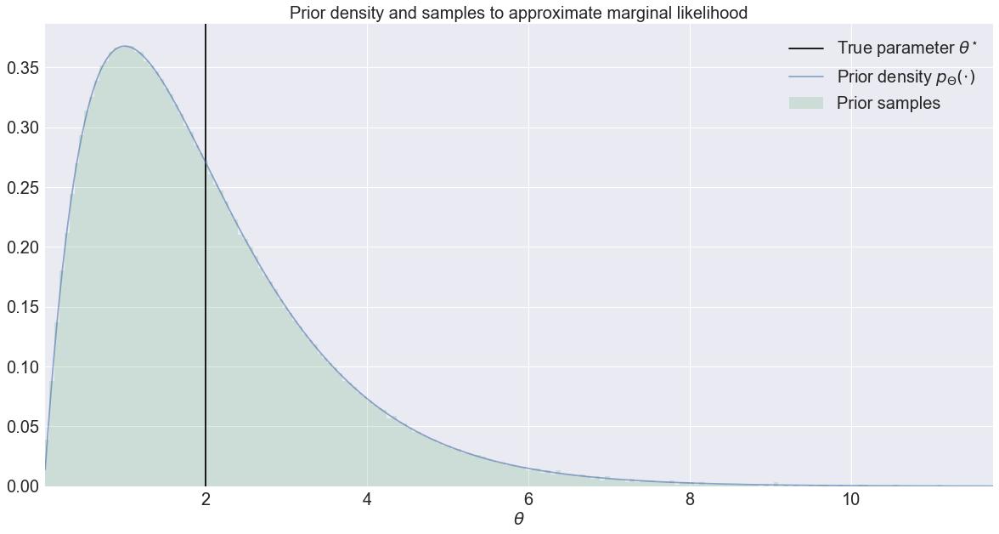

In [22]:
# Plot the prior density and samples
def temp_plot():
    
    # Setup
    sns.set()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((20, 10))
    
    # Computations
    t_min = prior_ppf(0.0001)
    t_max = prior_ppf(0.9999)
    t = np.linspace(t_min, t_max, 1000)
    
    # Plot
    plt.axvline(theta_true, c='k', label=r'True parameter $\theta^{\star}$')
    ax.plot(t, prior_pdf(t), alpha=0.6, label=r'Prior density $p_{\Theta}(\cdot)$')
    ax.hist(t_samples, bins=200, density=True, histtype='stepfilled', alpha=0.2, label='Prior samples')
    
    # Aesthetics
    ax.set_xlim((t_min, t_max))
    ax.set_title('Prior density and samples to approximate marginal likelihood', fontsize=20)
    ax.set_xlabel(r'$\theta$', fontsize=20)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(20) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(20)
    ax.legend(fontsize=20)

temp_plot()

### Hyperparameter Learning by Optimizing the Marginal Kernel Means Likelihood (MKML): Grid Search

In this section we will find globally and locally optimal hyperparameters for KELFI. We will keep the regularization parameter fixed so that there are only two hyperparameters to optimize to enable visualization. The two hyperparameters are the length scale of each of the two Gaussian kernels, on the space of the parameters and summary statistics.

We will first just do a slow exhaustive grid search here since it is two-dimensions. This also enables us to visualize the objective function surface to gain a better understanding.

We will then find the optimal hyperparameters, including the regularization hyperparameter, by using gradient ascent.

In [23]:
use_saved_grid_search_results = False

In [24]:
def hyperparameter_learning_objective(beta, eps, reg=None):
    """Computes the approximate MKML for different hyperparameters."""
    weights = kernel_means_weights(y, x_sim, t_sim, eps, beta, reg=reg)
    return approximate_marginal_kernel_means_likelihood(t_samples, t_sim, weights, beta)

In [25]:
beta_array = np.linspace(0.5, 1.5, 100)
eps_array = np.linspace(0.05, 0.15, 100)
eps_grid, beta_grid = np.meshgrid(eps_array, beta_array)

In [26]:
if use_saved_grid_search_results:
    beta_global, eps_global = 0.823, 0.079
    mkml_global = hyperparameter_learning_objective(beta_global, eps_global)
else:
    mkml_grid = np.zeros((beta_array.shape[0], eps_array.shape[0]))
    mkml_global = -np.inf
    for i, beta in enumerate(beta_array):
        for j, eps in enumerate(eps_array):
            mkml_grid[i, j] = hyperparameter_learning_objective(beta, eps)
            if mkml_grid[i, j] > mkml_global:
                mkml_global = mkml_grid[i, j]
                beta_global = beta
                eps_global = eps
            print('(i, j) = (%d, %d)' % (i, j), '| (beta_global, eps_global) = (%.3f, %.3f)' % (beta_global, eps_global), '| Optimal Approximate MKML: %.3f' % mkml_global)
            clear_output(wait=True)
print('(beta_global, eps_global) = (%.3f, %.3f)' % (beta_global, eps_global), '| Globally Optimal Approximate MKML: %.3f' % mkml_global)

(beta_global, eps_global) = (0.823, 0.079) | Globally Optimal Approximate MKML: 0.898


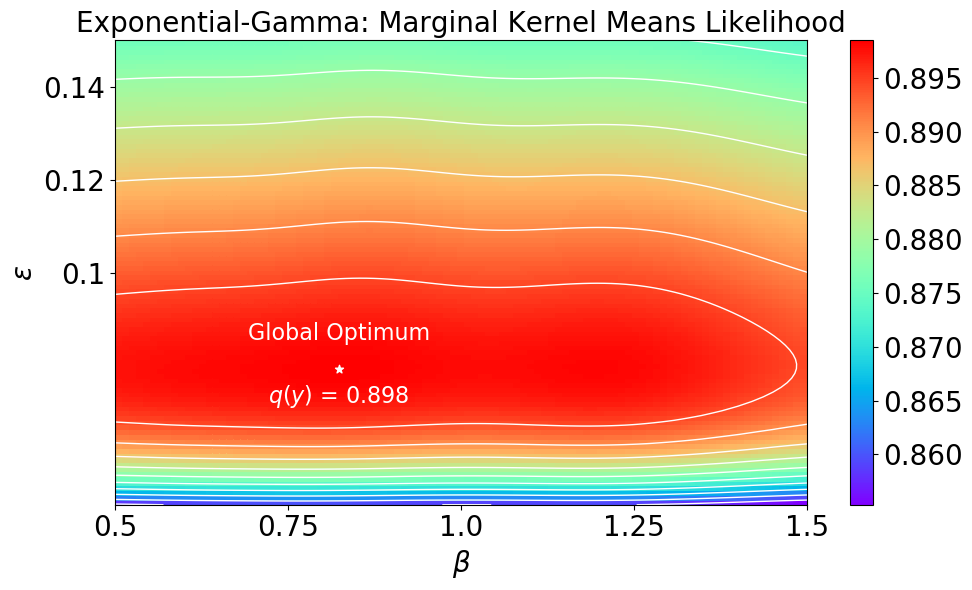

In [27]:
def temp_plot():
    
    # Setup
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))
    
    # Plot
    plt.pcolormesh(beta_grid, eps_grid, mkml_grid, cmap='rainbow')
    cb = plt.colorbar()
    plt.contour(beta_grid, eps_grid, mkml_grid, linewidths=1, colors='w', levels=np.linspace(mkml_grid.min(), mkml_grid.max(), 12))
    plt.scatter(beta_global, eps_global, marker='*', c='w')
    plt.text(beta_global, eps_global + 0.005, r'Global Optimum', color='w', ha='center', va='bottom', fontsize=16)
    plt.text(beta_global, eps_global - 0.003, r'$q(y)$ = %.3f' % mkml_global, color='w', ha='center', va='top', fontsize=16)

    # Aesthetics
    plt.title('Exponential-Gamma: Marginal Kernel Means Likelihood', fontsize=20)
    plt.xlabel(r'$\beta$', fontsize=20)
    plt.ylabel(r'$\epsilon$', fontsize=20)
    plt.gca().set_xticks(np.arange(0.5, 1.75, 0.25))
    plt.gca().set_xticklabels(np.round(np.arange(0.5, 1.75, 0.25), 2), fontsize=20)
    plt.gca().set_yticks(np.arange(0.1, 0.22, 0.02))
    plt.gca().set_yticklabels(np.round(np.arange(0.1, 0.22, 0.02), 2), fontsize=20)
    cb.ax.tick_params(labelsize=20)
    plt.xlim((beta_grid.min(), beta_grid.max()))
    plt.ylim((eps_grid.min(), eps_grid.max()))
    plt.tight_layout()
    plt.show()

if not use_saved_grid_search_results:
    temp_plot()

In [28]:
# Find the local optima seen above
# Plot the negative log approximate marginal likelihood
if use_saved_grid_search_results:
    beta_local, eps_local = 1.187, 0.079
    mkml_local = hyperparameter_learning_objective(beta_local, eps_local)
else:
    mkml_local = -np.inf
    for i in range(int(0.5 * beta_array.shape[0]), int(1 * beta_array.shape[0])):
        for j in range(eps_array.shape[0]):
            if mkml_grid[i, j] > mkml_local:
                mkml_local = mkml_grid[i, j]
                beta_local = beta_array[i]
                eps_local = eps_array[j]
    print('(beta_local, eps_local) = (%.3f, %.3f)' % (beta_local, eps_local), '| Locally Optimal Approximate MKML: %.3f' % mkml_local)

(beta_local, eps_local) = (1.187, 0.079) | Locally Optimal Approximate MKML: 0.898


In [29]:
# Pick some arbitrary hyperparameters that is not optimal
beta_arb, eps_arb = 1., 0.135
mkml_arb = hyperparameter_learning_objective(beta_arb, eps_arb)

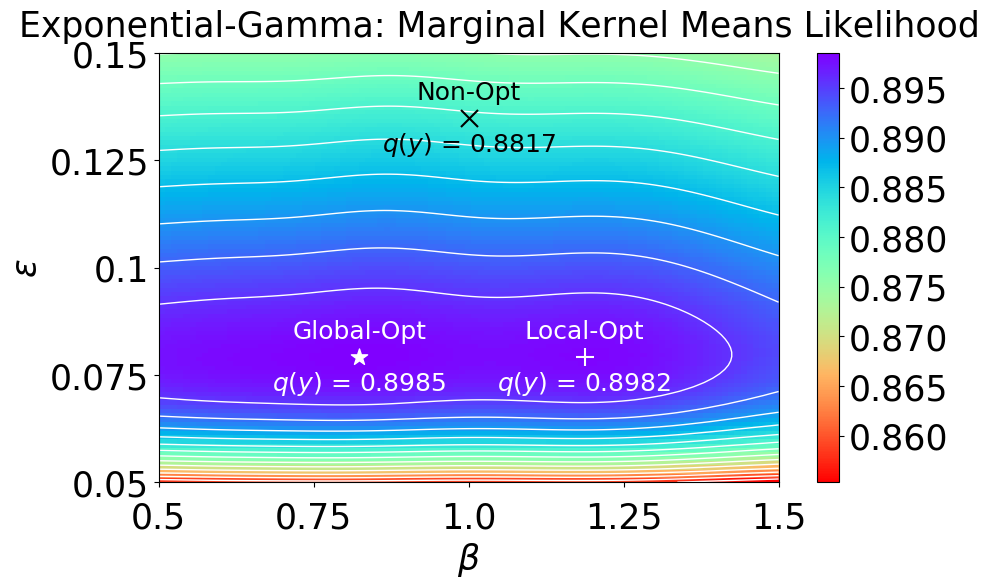

In [30]:
def temp_plot():
    
    # Setup
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))
    
    # Plot
    plt.pcolormesh(beta_grid, eps_grid, mkml_grid, cmap='rainbow_r')
    cb = plt.colorbar()
    plt.contour(beta_grid, eps_grid, mkml_grid, linewidths=1, colors='w', levels=np.linspace(mkml_grid.min(), mkml_grid.max(), 16))
    
    plt.scatter(beta_global, eps_global, marker='*', c='w', s=150)
    plt.scatter(beta_local, eps_local, marker='+', c='w', s=150)
    plt.scatter(beta_arb, eps_arb, marker='x', c='k', zorder=10, s=150)
    
    plt.text(beta_global, eps_global + 0.003, r'Global-Opt', color='w', ha='center', va='bottom', fontsize=18)
    plt.text(beta_global, eps_global - 0.003, r'$q(y)$ = %.4f' % mkml_global, color='w', ha='center', va='top', fontsize=18)
    plt.text(beta_local, eps_local + 0.003, r'Local-Opt', color='w', ha='center', va='bottom', fontsize=18)
    plt.text(beta_local, eps_local - 0.003, r'$q(y)$ = %.4f' % mkml_local, color='w', ha='center', va='top', fontsize=18)
    plt.text(beta_arb, eps_arb + 0.003, r'Non-Opt', color='k', ha='center', va='bottom', fontsize=18, zorder=10)
    plt.text(beta_arb, eps_arb - 0.003, r'$q(y)$ = %.4f' % mkml_arb, color='k', ha='center', va='top', fontsize=18, zorder=10)

    # Aesthetics
    plt.title('Exponential-Gamma: Marginal Kernel Means Likelihood', fontsize=25, x=0.55, y=1.02)
    plt.xlabel(r'$\beta$', fontsize=25)
    plt.ylabel(r'$\epsilon$', fontsize=25)
    plt.gca().set_xticks(np.arange(0.5, 1.75, 0.25))
    plt.gca().set_xticklabels(np.round(np.arange(0.5, 1.75, 0.25), 2), fontsize=25, y=-0.02)
    plt.gca().set_yticks(np.arange(0.05, 0.175, 0.025))
    plt.gca().set_yticklabels(np.round(np.arange(0.05, 0.175, 0.025), 3), fontsize=25)
    cb.ax.tick_params(labelsize=25)
    plt.xlim((beta_grid.min(), beta_grid.max()))
    plt.ylim((eps_grid.min(), eps_grid.max()))
    plt.tight_layout()
    fig.savefig('exponential_gamma_marginal_kernel_means_likelihood.pdf', format='pdf', dpi=1000)
    plt.show()

if not use_saved_grid_search_results:
    temp_plot()

Caption: The marginal kernel means likelihood surface used for hyperparameter learning. We show the global optimum, local optimum, and an arbitrary hyperparameter choice. We will later compare how their resulting approximate posteriors perform to demonstrate that higher MKML lead to better posterior approximations.

### Hyperparameter Learning by Optimizing the Marginal Kernel Means Likelihood (MKML): Gradient Descent with Automatic Differentiation

The hyperparameters are learned in log-space, and the minimization objective is the negative log marginal kernel means likelihood (NLMKML).

In [31]:
# Full hyperparameter learning with automatic differentiation
eps_tuple = (0.06, 'learn')
beta_tuple = (0.6, 'learn')
reg_tuple = (1e-6, 'learn')
eps_opt, beta_opt, reg_opt = kernel_means_hyperparameter_learning(
    y, x_sim, t_sim, eps_tuple, beta_tuple, reg_tuple,
    eps_ratios=1., beta_ratios=1., offset=0.,
    prior_samples=t_samples, prior_mean=None, prior_std=None,
    learning_rate=0.01, n_iter=5000, display_steps=100)
mkml_opt = hyperparameter_learning_objective(beta_opt, eps_opt, reg=reg_opt)
print('(beta_opt, eps_opt) = (%.3f, %.3f)' % (beta_opt, eps_opt), '| Optimal Approximate MKML: %.3f' % mkml_opt)

i:  0  | eps:  0.06  | beta:  0.6  | reg:  9.999998e-07  | ml:  0.8856594
i:  100  | eps:  0.06564987  | beta:  0.57439  | reg:  9.973235e-07  | ml:  0.89167684
i:  200  | eps:  0.06937656  | beta:  0.56184316  | reg:  9.936922e-07  | ml:  0.896333
i:  300  | eps:  0.071960665  | beta:  0.5623876  | reg:  9.905878e-07  | ml:  0.9092826
i:  400  | eps:  0.07376076  | beta:  0.56118864  | reg:  9.868284e-07  | ml:  0.89196056
i:  500  | eps:  0.07508303  | beta:  0.56184715  | reg:  9.821013e-07  | ml:  0.8968509
i:  600  | eps:  0.07617081  | beta:  0.5572076  | reg:  9.810677e-07  | ml:  0.90188223
i:  700  | eps:  0.076950215  | beta:  0.5566903  | reg:  9.800204e-07  | ml:  0.8957662
i:  800  | eps:  0.077481054  | beta:  0.55751467  | reg:  9.78626e-07  | ml:  0.8986096
i:  900  | eps:  0.077920005  | beta:  0.5576684  | reg:  9.781016e-07  | ml:  0.89866054
i:  1000  | eps:  0.0782321  | beta:  0.5565424  | reg:  9.770351e-07  | ml:  0.8986588
i:  1100  | eps:  0.07849151  | beta: 

### Approximate Posteriors using Kernel Means Posterior (KMP)

In [32]:
def kmp_kmpe_mkml(t_query, beta, eps, reg=None, beta_query=None):
    """Computes the KMP, KMPE, and MKML under different hyperparameters"""
    weights = kernel_means_weights(y, x_sim, t_sim, eps, beta, reg=reg)
    mkml = approximate_marginal_kernel_means_likelihood(t_samples, t_sim, weights, beta)
    kmp = kernel_means_posterior(t_query, t_sim, weights, beta, prior_pdf, mkml)
    kmpe = approximate_kernel_means_posterior_embedding(t_query, t_sim, weights, beta, t_samples, marginal_likelihood=mkml, beta_query=beta_query)
    return kmp, kmpe, mkml

In [33]:
t_min = 0
t_max = 6
t_query = np.linspace(t_min, t_max, 1000)[:, np.newaxis]

In [34]:
# Pick a length scale for kernel herding
# This does not need to be the same as the beta that was learned for the KML, MKML, and KMP! 
# This represents the degree of precision you want to learn your posterior to
# Small length scales will require a lot of super-samples and takes longer
# Large legnth scales will only need a small number of super-samples but approximation will be more crude
beta_query = 0.1

In [35]:
# Compute the KMP, KMPE, and MKML
kmp_opt_query, kmpe_opt_query, mkml_opt = kmp_kmpe_mkml(t_query, beta_opt, eps_opt, reg=reg_opt, beta_query=beta_query)
kmp_global_query, kmpe_global_query, mkml_global = kmp_kmpe_mkml(t_query, beta_global, eps_global, reg=None, beta_query=beta_query)
kmp_local_query, kmpe_local_query, mkml_local = kmp_kmpe_mkml(t_query, beta_local, eps_local, reg=None, beta_query=beta_query)
kmp_arb_query, kmpe_arb_query, mkml_arb = kmp_kmpe_mkml(t_query, beta_arb, eps_arb, reg=None, beta_query=beta_query)

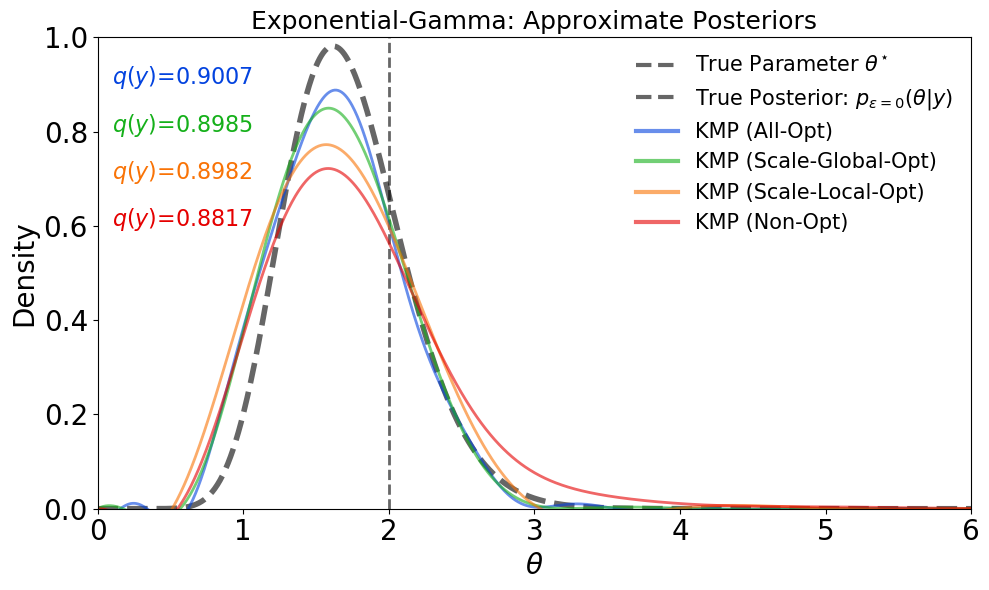

In [36]:
def temp_plot():

    # Setup
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))
    
    # Computations
    t = t_query.ravel()
    
    # Plot
    ax.axvline(theta_true, c='k', linestyle='--', linewidth=2.0, alpha=0.6, label=r'True Parameter $\theta^{\star}$')
    ax.plot(t, posterior_pdf(t, y_data[0]), c='k', linestyle='--', linewidth=4.0, alpha=0.6, label=r'True Posterior: $p_{\epsilon=0}(\theta | y)$')
    
    ax.plot(t, kmp_opt_query, c=sns.xkcd_rgb['blue'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KMP (All-Opt)')
    ax.plot(t, kmp_global_query, c=sns.xkcd_rgb['green'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KMP (Scale-Global-Opt)')
    ax.plot(t, kmp_local_query, c=sns.xkcd_rgb['orange'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KMP (Scale-Local-Opt)')
    ax.plot(t, kmp_arb_query, c=sns.xkcd_rgb['red'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KMP (Non-Opt)')
    
    # Annotations
    ax.text(0.1, 0.9, r'$q(y)$=%.4f' % mkml_opt, color=sns.xkcd_rgb['blue'], fontsize=16)
    ax.text(0.1, 0.8, r'$q(y)$=%.4f' % mkml_global, color=sns.xkcd_rgb['green'], fontsize=16)
    ax.text(0.1, 0.7, r'$q(y)$=%.4f' % mkml_local, color=sns.xkcd_rgb['orange'], fontsize=16)
    ax.text(0.1, 0.6, r'$q(y)$=%.4f' % mkml_arb, color=sns.xkcd_rgb['red'], fontsize=16)
 
    # Aesthetics
    ax.set_xlim((0, 6))
    ax.set_ylim((0, 1))
    ax.set_title(r'Exponential-Gamma: Approximate Posteriors', fontsize=18)
    ax.set_xlabel(r'$\theta$', fontsize=20)
    ax.set_ylabel(r'Density', fontsize=20)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(20) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(20)
    plt.tight_layout()
    leg = ax.legend(fontsize=15, loc='upper right', bbox_to_anchor=(1, 1), frameon=False)
    for legobj in leg.legendHandles:
        legobj.set_linewidth(3.0)
    fig.savefig('exponential_gamma_kernel_means_posteriors.pdf', format='pdf', dpi=1000)
    
temp_plot()

Caption: Kernel Means Posteriors (KMP) for different hyperparameter choices. For All-Opt, all hyperparameters including regularization hyperparameters were optimized. For Scale-Opt, only length scale hyperparameters are optimized and regularization hyperparameters are kept fixed. The global and local optima are shown. For Non-Opt, arbitrary hyperparameters that are not optimized were chosen. Note that with 100 simulations it is very difficult to get an accurate posterior approximation. The value in the brackets show the corresponding MKML. This shows that higher MKML lead to more accurate KMPs. 

### Approximate Posteriors by Super-Sampling the Kernel Means Posterior Embedding

This is the full KELFI solution.

In [37]:
from kernels import gaussian_kernel_gramix, gaussian_density_gramix
from kernel_means_inference import kernel_herding


def kde(samples, query_points, ls, weights=None):
    """KDE for visualizing samples."""
    if weights is None:
        return gaussian_density_gramix(samples, query_points, ls).mean(axis=0)
    else:
        return np.dot(weights, gaussian_density_gramix(samples, query_points, ls))

In [38]:
def kelfi(beta, eps, reg=None, n_samples=1000, beta_query=None):
    """Full KELFI Solution."""
    weights = kernel_means_weights(y, x_sim, t_sim, eps, beta, reg=reg)
    mkml = approximate_marginal_kernel_means_likelihood(t_samples, t_sim, weights, beta)
    if beta_query is None:
        beta_query = beta
    kernel_function = lambda t1, t2: gaussian_kernel_gramix(t1, t2, beta_query)
    kmpe_ = approximate_kernel_means_posterior_embedding(t_samples, t_sim, weights, beta, t_samples, marginal_likelihood=mkml, beta_query=beta_query)
    t_kmpe = kernel_herding(kmpe_, kernel_function, t_samples, n_samples)
    return t_kmpe

In [39]:
# Obtain posterior super-samples from the KMPE
n_samples = 10000
t_kmpe_opt = kelfi(beta_opt, eps_opt, reg=reg_opt, n_samples=n_samples, beta_query=beta_query)
t_kmpe_global = kelfi(beta_global, eps_global, reg=None, n_samples=n_samples, beta_query=beta_query)
t_kmpe_local = kelfi(beta_local, eps_local, reg=None, n_samples=n_samples, beta_query=beta_query)
t_kmpe_arb = kelfi(beta_arb, eps_arb, reg=None, n_samples=n_samples, beta_query=beta_query)

c:\users\kelvy\envs\tensorflow-gpu\lib\site-packages\ipykernel_launcher.py:53: RuntimeWarning: Mean of empty slice.
c:\users\kelvy\envs\tensorflow-gpu\lib\site-packages\numpy\core\_methods.py:73: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
c:\users\kelvy\envs\tensorflow-gpu\lib\site-packages\ipykernel_launcher.py:54: RuntimeWarning: Mean of empty slice.
Animation size has reached 21048585 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


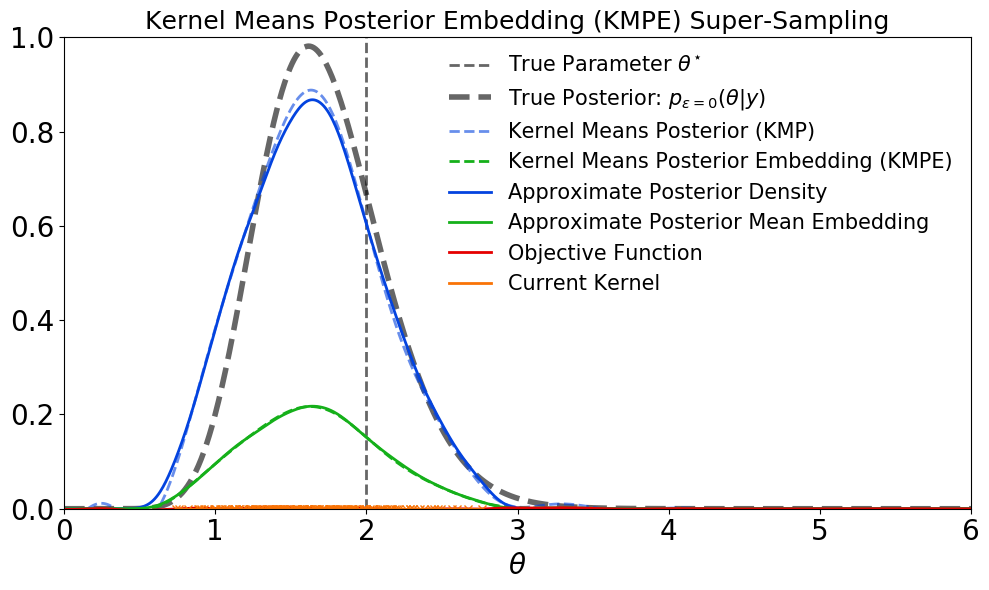

In [40]:
from IPython.display import HTML

# Here we visualize the kernel herding procedure for the optimal embedding
def animate_kernel_herding(t_query, density_query, mean_embedding_query, samples, beta_query=0.1, frames=None):
    
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))

    t = t_query.ravel()
    ax.axvline(theta_true, c='k', linestyle='--', linewidth=2.0, alpha=0.6, label=r'True Parameter $\theta^{\star}$')
    ax.plot(t, posterior_pdf(t, y_data[0]), c='k', linestyle='--', linewidth=4.0, alpha=0.6, label=r'True Posterior: $p_{\epsilon=0}(\theta | y)$')
    
    ax.plot(t, density_query, c=sns.xkcd_rgb['blue'], linewidth=2.0, linestyle='--', alpha=0.6, label=r'Kernel Means Posterior (KMP)')
    ax.plot(t, mean_embedding_query, c=sns.xkcd_rgb['green'], linewidth=2.0, linestyle='--', label='Kernel Means Posterior Embedding (KMPE)')
    
    line_1, = ax.plot([], [], c=sns.xkcd_rgb['blue'], lw=2, label='Approximate Posterior Density')
    line_2, = ax.plot([], [], c=sns.xkcd_rgb['green'], lw=2, label='Approximate Posterior Mean Embedding')
    line_3, = ax.plot([], [], c=sns.xkcd_rgb['red'], lw=2, label='Objective Function')
    line_4, = ax.plot([], [], c=sns.xkcd_rgb['orange'], lw=2, label='Current Kernel')
    line_5, = ax.plot([], [], marker='x', c=sns.xkcd_rgb['orange'], lw=2)
    

    ax.legend(fontsize=15, loc='upper right', bbox_to_anchor=(1, 1), frameon=False)
    ax.set_xlim((0, 6))
    ax.set_ylim((0, 1))
    ax.set_title('Kernel Means Posterior Embedding (KMPE) Super-Sampling', fontsize=18)
    ax.set_xlabel(r'$\theta$', fontsize=20)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(20) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(20)
    plt.tight_layout()

    def init():
        line_1.set_data([], [])
        line_2.set_data([], [])
        line_3.set_data([], [])
        line_4.set_data([], [])
        line_5.set_data([], [])
        return line_1, line_2, line_3, line_4, line_5

    if frames is None:
        frames = samples.shape[0]
    mu = mean_embedding_query
    kernel_function = lambda t1, t2: gaussian_kernel_gramix(t1, t2, beta_query)
    def animate(i):
        mu_hat_sum = kernel_function(samples[:i], t_query).sum(axis=0)
        mu_hat = mu_hat_sum / (i + 1)
        objective = mu - mu_hat
        
        line_1.set_data(t, gaussian_density_gramix(samples[:i], t_query, beta_query).mean(axis=0))
        line_2.set_data(t, kernel_function(samples[:i], t_query).mean(axis=0))
        line_3.set_data(t, objective)
        line_4.set_data(t, kernel_function(samples[[i]], t_query).ravel()) if i < frames - 1 else line_4.set_data(0, 0)
        line_5.set_data(samples[:i], 0)
        
        return line_1, line_2, line_3, line_4, line_5
    
    from matplotlib import animation, rc
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=frames, interval=frames, repeat_delay=1000,
                                   blit=True)
    return anim.to_jshtml()

HTML(animate_kernel_herding(t_query, kmp_opt_query, kmpe_opt_query, t_kmpe_opt, beta_query if beta_query is not None else beta_opt, frames=150))

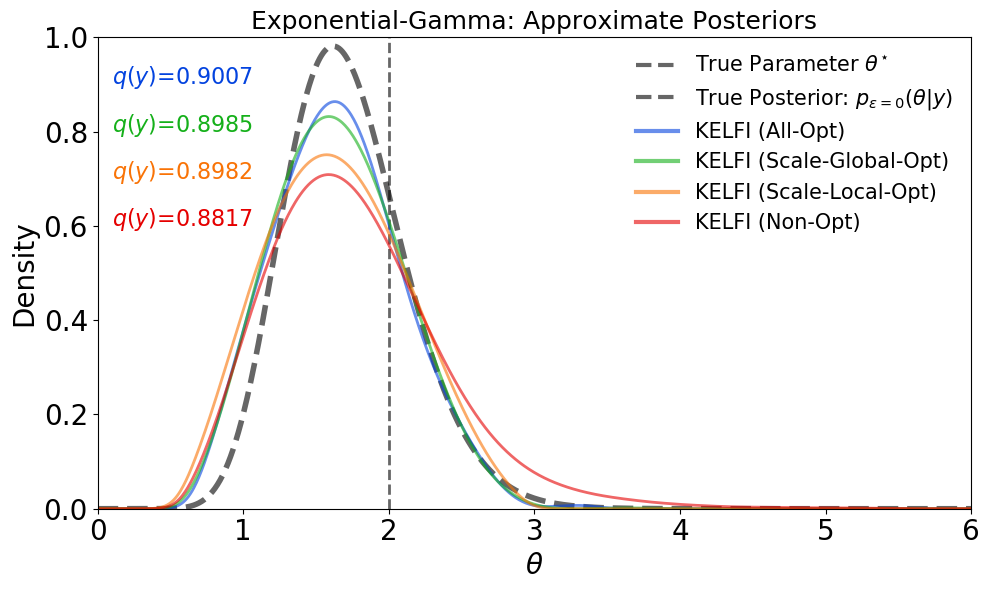

In [41]:
def temp_plot():

    # Setup
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))
    
    # Computations
    t = t_query.ravel()
    
    # Plot
    ax.axvline(theta_true, c='k', linestyle='--', linewidth=2.0, alpha=0.6, label=r'True Parameter $\theta^{\star}$')
    ax.plot(t, posterior_pdf(t, y_data[0]), c='k', linestyle='--', linewidth=4.0, alpha=0.6, label=r'True Posterior: $p_{\epsilon=0}(\theta | y)$')
    
    ls = 0.1
    n_samples = 10000
    ax.plot(t, kde(t_kmpe_opt[:n_samples], t_query, ls), c=sns.xkcd_rgb['blue'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KELFI (All-Opt)')
    ax.plot(t, kde(t_kmpe_global[:n_samples], t_query, ls), c=sns.xkcd_rgb['green'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KELFI (Scale-Global-Opt)')
    ax.plot(t, kde(t_kmpe_local[:n_samples], t_query, ls), c=sns.xkcd_rgb['orange'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KELFI (Scale-Local-Opt)')
    ax.plot(t, kde(t_kmpe_arb[:n_samples], t_query, ls), c=sns.xkcd_rgb['red'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KELFI (Non-Opt)')
    
    # Annotations
    ax.text(0.1, 0.9, r'$q(y)$=%.4f' % mkml_opt, color=sns.xkcd_rgb['blue'], fontsize=16)
    ax.text(0.1, 0.8, r'$q(y)$=%.4f' % mkml_global, color=sns.xkcd_rgb['green'], fontsize=16)
    ax.text(0.1, 0.7, r'$q(y)$=%.4f' % mkml_local, color=sns.xkcd_rgb['orange'], fontsize=16)
    ax.text(0.1, 0.6, r'$q(y)$=%.4f' % mkml_arb, color=sns.xkcd_rgb['red'], fontsize=16)
    
    # Aesthetics
    ax.set_xlim((t_min, 6))
    ax.set_ylim((0, 1))
    ax.set_title(r'Exponential-Gamma: Approximate Posteriors', fontsize=18)
    ax.set_xlabel(r'$\theta$', fontsize=20)
    ax.set_ylabel(r'Density', fontsize=20)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(20) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(20)
    plt.tight_layout()
    leg = ax.legend(fontsize=15, loc='upper right', bbox_to_anchor=(1, 1), frameon=False)
    for legobj in leg.legendHandles:
        legobj.set_linewidth(3.0)
    fig.savefig('exponential_gamma_kernel_means_posterior_embedding_sampling.pdf', format='pdf', dpi=1000)
    
temp_plot()

### Other Kernel-Based Likelihood-Free Inference Methods

Below we will compare to other kernel based likelihood-free inference approaches.

In [42]:
%%file gps_abc.py
"""
Gaussian process surrogate approximate Bayesian computation (GPS-ABC) [Meeds and Welling 2014]

Implementation is based on original paper

Not documented fully yet
"""
import numpy as np
from scipy import stats
from scipy import linalg as la


def rejection_abc_posterior_sampler(y, prior_sampler, likelihood_sampler, distance_function, eps,
                                    n_samples=10000, n_iter=10000, verbose=True):
    
    posterior_samples = []
    calls_history = []
    
    for i in range(n_iter):
        
        theta = prior_sampler()
        x = likelihood_sampler(theta)
        
        if distance_function(x, y) < eps:
            posterior_samples.append(theta)
            calls_history.append(likelihood_sampler.calls)
            if verbose:
                print('Accepted %d samples - currently used %d simulation calls' % (len(posterior_samples), likelihood_sampler.calls))
            
        if len(posterior_samples) >= n_samples:
            break
    
    return np.array(posterior_samples), np.array(calls_history)


def mnpdf(x, mean=None, cov=None):
    
    for jitter in np.linspace(0, np.max(cov), 1000):
        try:
            jitter_cov = cov + jitter * np.eye(cov.shape[0])
            return stats.multivariate_normal.pdf(x, mean=mean, cov=jitter_cov)
        except:
            print('\t\tNormal pdf requires jittering - so far jittered by %.2f' % jitter)
            
    
def sl_abc_mh_step(y, theta, prior_density, likelihood_sampler, n_sim, eps, proposal_std, return_x_sim=False):
    
    theta_proposal = theta + np.random.randn(theta.shape[0]) * proposal_std

    x_sim = []
    x_sim_proposal = []
    
    for s in range(n_sim):
        
        x_sim.append(likelihood_sampler(theta))
        x_sim_proposal.append(likelihood_sampler(theta_proposal))
        
    x_sim, x_sim_proposal = np.array(x_sim), np.array(x_sim_proposal)
    
    mu_sim = np.mean(x_sim, axis=0)
    sigma_sim = np.dot(np.transpose(x_sim - mu_sim), x_sim - mu_sim) / (n_sim - 1)
    mu_sim_proposal = np.mean(x_sim_proposal, axis=0)
    sigma_sim_proposal = np.dot(np.transpose(x_sim_proposal - mu_sim_proposal), x_sim_proposal - mu_sim_proposal) / (n_sim - 1)    
    
    # d = y.shape[0]
    # assert mu_sim.shape == (d,)
    # assert sigma_sim.shape == (d, d)
    
    prior_ratio = prior_density(theta_proposal) / prior_density(theta)
    likelihood_ratio = mnpdf(y, mean=mu_sim_proposal, cov=sigma_sim_proposal) / mnpdf(y, mean=mu_sim, cov=sigma_sim)
    
    alpha = prior_ratio * likelihood_ratio

    if return_x_sim:
        return (theta_proposal, x_sim_proposal) if np.random.rand() < alpha else (theta, x_sim)
    else:
        return theta_proposal if np.random.rand() < alpha else theta
    

def sl_abc_posterior_sampler(y, prior_density, prior_sampler, likelihood_sampler, n_sim, eps, proposal_std, 
                             eps_init=None, n_samples=10000, verbose=True, return_x_sim=False):
    
    distance_function = lambda x, y: np.sqrt(np.sum((x - y) ** 2))
    theta = rejection_abc_posterior_sampler(y, prior_sampler, likelihood_sampler, 
                                            distance_function, eps_init,
                                            n_samples=1, n_iter=n_samples, verbose=False)[0][0]
    
    posterior_samples = []
    calls_history = []
    if return_x_sim:
        x_sim_list = []
    
    for i in range(n_samples):
        
        if return_x_sim:
            theta, x_sim = sl_abc_mh_step(y, theta, prior_density, likelihood_sampler, n_sim, eps, proposal_std, return_x_sim=True)
            x_sim_list.append(x_sim)
        else:
            theta = sl_abc_mh_step(y, theta, prior_density, likelihood_sampler, n_sim, eps, proposal_std, return_x_sim=False)
        posterior_samples.append(theta)
        calls_history.append(likelihood_sampler.calls)
        print('Proposal for sample %d %s - currently used %d simulation calls ' % (i, 'rejected' if np.allclose(theta, posterior_samples[i - 1]) else 'accepted', likelihood_sampler.calls)) if verbose and i > 0 else None
        
    if return_x_sim:
        return np.array(posterior_samples), np.array(x_sim_list), np.array(calls_history)
    else:
        return np.array(posterior_samples), np.array(calls_history)


def asl_abc_mh_step(y, theta, prior_density, likelihood_sampler, s_0, ds, m, eps, error_tol, proposal_std):
    
    theta_proposal = theta + np.random.randn(theta.shape[0]) * proposal_std

    c = 0
    S = s_0
    
    reg = eps ** 2 * np.eye(y.shape[-1])

    x_sim = []
    x_sim_proposal = []
    
    while True:
        
        for s in range(c, c + S):
            
            x_sim.append(likelihood_sampler(theta))
            x_sim_proposal.append(likelihood_sampler(theta_proposal))            

        c = S
        S += ds
        
        n_samples = len(x_sim)
        x_sim_, x_sim_proposal_ = np.array(x_sim), np.array(x_sim_proposal)

        mu_sim = np.mean(x_sim_, axis=0)
        sigma_sim = np.dot(np.transpose(x_sim_ - mu_sim), x_sim_ - mu_sim) / (n_samples - 1)
        mu_sim_proposal = np.mean(x_sim_proposal_, axis=0)
        sigma_sim_proposal = np.dot(np.transpose(x_sim_proposal_ - mu_sim_proposal), x_sim_proposal_ - mu_sim_proposal) / (n_samples - 1)    
        
        alpha = np.zeros(m)
        
        for i in range(m):
            
            mu_sim_sample = stats.multivariate_normal.rvs(mean=mu_sim, cov=sigma_sim/n_samples)
            mu_sim_proposal_sample = stats.multivariate_normal.rvs(mean=mu_sim_proposal, cov=sigma_sim_proposal/n_samples)
            
            prior_ratio = prior_density(theta_proposal) / prior_density(theta)
            likelihood_ratio = mnpdf(y, mean=mu_sim_proposal_sample, cov=sigma_sim_proposal+reg) / mnpdf(y, mean=mu_sim_sample, cov=sigma_sim+reg)

            alpha[i] = prior_ratio * likelihood_ratio
            
        tau = np.median(alpha)
        
        n_unif_samples = m  # Does not have to be m
        u_samples = np.random.rand(n_unif_samples)
        error = np.mean([np.mean(alpha < u) if u <= tau else np.mean(alpha >= u) for u in u_samples])
        
        if error < error_tol:
            break
        print('\tError is still %.3f when using %d samples - continue to next iteration' % (error, n_samples))
            
    return theta_proposal if np.random.rand() < tau else theta
        

def asl_abc_posterior_sampler(y, prior_density, prior_sampler, likelihood_sampler, s_0, ds, m, eps, error_tol, proposal_std,
                              eps_init=None, n_samples=10000, verbose=True):
    
    distance_function = lambda x, y: np.sqrt(np.sum((x - y) ** 2))
    theta = rejection_abc_posterior_sampler(y, prior_sampler, likelihood_sampler, 
                                            distance_function, eps_init,
                                            n_samples=1, n_iter=n_samples, verbose=verbose)[0][0]
    
    posterior_samples = []
    calls_history = []
    
    for i in range(n_samples):
        
        theta = asl_abc_mh_step(y, theta, prior_density, likelihood_sampler, s_0, ds, m, eps, error_tol, proposal_std)
        posterior_samples.append(theta)
        calls_history.append(likelihood_sampler.calls)
        print('Proposal for sample %d %s - currently used %d simulation calls ' % (i, 'rejected' if np.allclose(theta, posterior_samples[i - 1]) else 'accepted', likelihood_sampler.calls)) if verbose and i > 0 else None
        
    return np.array(posterior_samples), np.array(calls_history)


def gps_abc_mh_step(y, theta, prior_density, s_0, ds, m, eps, error_tol, proposal_std, gp_predict, verbose=True):
    
    theta_proposal = theta + np.random.randn(theta.shape[0]) * proposal_std
    
    d = y.shape[-1]
    
    # The original paper does not use covariance so we will not use it here, although it can be done
    gp_mu, gp_std = gp_predict(np.array([theta, theta_proposal]))
            
    while True:
        
        alpha = np.zeros(m)
        
        for i in range(m):
            
            mu_sim_sample = np.random.randn(d) * gp_std[0, :] + gp_mu[0, :]
            mu_sim_proposal_sample = np.random.randn(d) * gp_std[1, :] + gp_mu[1, :]
            
            prior_ratio = prior_density(theta_proposal) / prior_density(theta)
            likelihood_ratio_top = stats.norm.pdf(y, loc=mu_sim_proposal_sample, scale=np.sqrt(gp_std[1, :]**2 + eps**2))
            likelihood_ratio_bot = stats.norm.pdf(y, loc=mu_sim_sample, scale=np.sqrt(gp_std[0, :]**2 + eps**2))
            likelihood_ratio = np.prod(likelihood_ratio_top / likelihood_ratio_bot)
            alpha[i] = prior_ratio * likelihood_ratio
            
        tau = np.median(alpha)
        
        n_unif_samples = m  # Does not have to be m
        u_samples = np.random.rand(n_unif_samples)
        error = np.mean([np.mean(alpha < u) if u <= tau else np.mean(alpha >= u) for u in u_samples])
        
        if error < error_tol:
            break
        else:
            acq = True
            return (theta_proposal, acq)
        
    acq = False
    return (theta_proposal, acq) if np.random.rand() < tau else (theta, acq)


def gps_abc_sampler(y, prior_density, prior_sampler, likelihood_sampler, s_0, ds, m, eps, error_tol, proposal_std,
                    eps_init=None, n_samples=10000, n_iter=100000, verbose=True):

    from sklearn.gaussian_process import GaussianProcessRegressor
    
    theta_samples, x_samples, _ = sl_abc_posterior_sampler(y, prior_density, prior_sampler, likelihood_sampler, 
                                                           ds, eps, proposal_std, eps_init=eps_init, n_samples=s_0, return_x_sim=True)
    # The GPS-ABC algorithm is only designed to take one x at one theta
    x_samples = x_samples[:, 0, :]
    
    posterior_samples = theta_samples.copy()
    calls_history = []
    
    
    gps = [GaussianProcessRegressor().fit(theta_samples, x_samples[:, j]) for j in range(y.shape[-1])]
    
    # Start off with the best theta (this wasn't mentioned in the paper but we will do this to make GPS start off well)
    theta = theta_samples[np.argmax(np.sum((x_samples - y) ** 2, axis=-1))]
    
    print('Initialized GPS - starting GPS-ABC...') if verbose else None
    
    for i in range(n_iter):

        def gp_predict(theta_query):

            mu = np.zeros((theta_query.shape[0], y.shape[0]))
            std = np.zeros((theta_query.shape[0], y.shape[0]))
            
            for j in range(y.shape[0]):
                mu[:, j], std[:, j] = gps[j].predict(theta_query, return_std=True)
                
            # (n_query, d)
            return mu, std
            
        theta_proposal, acq = gps_abc_mh_step(y, theta, prior_density, s_0, ds, m, eps, error_tol, proposal_std, gp_predict, verbose=verbose)
        theta = theta_proposal  # This is already rejected or accepted in the step
        
        # Remember posterior samples does not have to be the same as the samples used to train the GP
        if acq:
            x_proposal = likelihood_sampler(theta_proposal)
            theta_samples = np.concatenate((theta_samples, np.array([theta_proposal])), axis=0)
            x_samples = np.concatenate((x_samples, np.array([x_proposal])), axis=0)
            gps = [GaussianProcessRegressor().fit(theta_samples, x_samples[:, j]) for j in range(y.shape[0])]
            print('Step %d: Acquiring a new point for %d total points to train the Gaussian process' % (i, theta_samples.shape[0])) if verbose else None
            
        else:
            
            posterior_samples = np.concatenate((posterior_samples, np.array([theta_proposal])), axis=0)
            calls_history.append(likelihood_sampler.calls)
            print('Step %d: Accepting current sample' % i) if verbose else None
            
        if len(posterior_samples) >= n_samples:
            break
            
            
    return posterior_samples, np.array(calls_history)

Overwriting gps_abc.py


In [43]:
%%file kme_abc.py
"""
Other approximate Bayesian computation methods using the kernel mean embedding framework.

- K-ABC (K1-ABC) [Nakagome et. al. 2013]
- K2-ABC [Park et. al. 2016]
- KBR (KBR-ABC) [Fukumizu et. al. 2013, Song et. al. 2013] (There are two versions provided by Song et. al. (2013))

Implementation is based on original papers

Not documented fully yet
"""
import numpy as np
from kernels import gaussian_kernel_gramix
from scipy import linalg as la


def k1_abc_weights(y, x_sim, theta_sim, gamma, reg):
    
    m, d = x_sim.shape

    k = gaussian_kernel_gramix(x_sim, x_sim, gamma)
    k_y = gaussian_kernel_gramix(x_sim, y, gamma)
    
    lower = True
    chol = la.cholesky(k + m * reg * np.eye(m), lower=lower)
    weights = la.cho_solve((chol, lower), k_y)
    
    return weights.ravel()

    
def k2_abc_weights(y_data, x_data_sim, theta_sim, eps):
    
    m, n = x_data_sim.shape
    
    weights = np.zeros(m)
    
    gamma = np.median(np.abs(y_data[:, np.newaxis] - y_data[np.newaxis, :]))
    
    y_data_ = y_data[:, np.newaxis]
    
    for j in range(m):
        x_data_ = x_data_sim[j][:, np.newaxis]
        
        k_xx = gaussian_kernel_gramix(x_data_, x_data_, gamma)
        k_yy = gaussian_kernel_gramix(y_data_, y_data_, gamma)
        k_xy = gaussian_kernel_gramix(x_data_, y_data_, gamma)
        
        m_xx = (np.sum(k_xx) - np.sum(k_xx.diagonal())) / (k_xx.shape[0] * (k_xx.shape[0] - 1))
        m_yy = (np.sum(k_yy) - np.sum(k_yy.diagonal())) / (k_yy.shape[0] * (k_yy.shape[0] - 1))
        m_xy = np.mean(k_xy)
        mmdsq = m_xx - 2 * m_xy + m_yy
        weights[j] = np.exp(- mmdsq / eps)
        
    return weights.ravel() / weights.sum()


def kbr_1_abc_weights(y, x_sim, t_sim, t_prior, ls_x, ls_t, reg_x, reg_t):
    
    m, d = x_sim.shape

    n_prior = t_prior.shape[0]
    
    k = gaussian_kernel_gramix(x_sim, x_sim, ls_x)
    k_y = gaussian_kernel_gramix(x_sim, y, ls_x)
    
    l = gaussian_kernel_gramix(t_sim, t_sim, ls_t)
    l_prior = gaussian_kernel_gramix(t_sim, t_prior, ls_t)
    
    w_prior = np.ones(n_prior) / n_prior
    
    lower = True
    chol = la.cholesky(l + m * reg_t * np.eye(m), lower=lower)
    diag = np.diag(la.cho_solve((chol, lower), np.dot(l_prior, w_prior)))
    lamb = la.cho_solve((chol, lower), np.dot(l_prior, np.diag(w_prior)))
    
    dk = np.dot(diag, k)
    dk2 = np.dot(dk, dk)
    
    lower = True
    chol = la.cholesky(dk2 + m * reg_x * np.eye(m), lower=lower)
    weights = np.dot(lamb.transpose(), la.cho_solve((chol, lower), np.dot(np.dot(k, diag), k_y)))
    
    return weights.ravel()


def kbr_2_abc_weights(y, x_sim, t_sim, t_prior, ls_x, ls_t, reg_x, reg_t):
    
    m, d = x_sim.shape

    n_prior = t_prior.shape[0]
    
    k = gaussian_kernel_gramix(x_sim, x_sim, ls_x)
    k_y = gaussian_kernel_gramix(x_sim, y, ls_x)
    
    l = gaussian_kernel_gramix(t_sim, t_sim, ls_t)
    l_prior = gaussian_kernel_gramix(t_sim, t_prior, ls_t)
    
    w_prior = np.ones(n_prior) / n_prior
    
    lower = True
    chol = la.cholesky(l + m * reg_t * np.eye(m), lower=lower)
    diag = np.diag(la.cho_solve((chol, lower), np.dot(l_prior, w_prior)))
    
    dk = np.dot(diag, k)
    dk2 = np.dot(dk, dk)
    
    lower = True
    chol = la.cholesky(dk2 + m * reg_x * np.eye(m), lower=lower)
    weights = np.dot(dk, la.cho_solve((chol, lower), np.dot(diag, k_y)))
    
    return weights.ravel()

Overwriting kme_abc.py


In [44]:
# This is for visualizing the kernel herding procedure for other kernel mean embeddings approaches that produce posterior mean embeddings directly
def animate_kernel_herding(t_query, density_query, mean_embedding_query, samples, ls_sample=0.1, ls_vis=0.1, frames=None):
    
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))

    t = t_query.ravel()
    ax.axvline(theta_true, c='k', linestyle='--', linewidth=2.0, alpha=0.6, label=r'True Parameter $\theta^{\star}$')
    ax.plot(t, posterior_pdf(t, y_data[0]), c='k', linestyle='--', linewidth=4.0, alpha=0.6, label=r'True Posterior: $p_{\epsilon=0}(\theta | y)$')
    
    ax.plot(t, density_query, c=sns.xkcd_rgb['blue'], linewidth=2.0, linestyle='--', alpha=0.6, label=r'Posterior Surrogate Density')
    ax.plot(t, mean_embedding_query, c=sns.xkcd_rgb['green'], linewidth=2.0, linestyle='--', label='Posterior Mean Embedding')
    
    line_1, = ax.plot([], [], c=sns.xkcd_rgb['blue'], lw=2, label='Approximate Posterior Density')
    line_2, = ax.plot([], [], c=sns.xkcd_rgb['green'], lw=2, label='Approximate Posterior Mean Embedding')
    line_3, = ax.plot([], [], c=sns.xkcd_rgb['red'], lw=2, label='Objective Function')
    line_4, = ax.plot([], [], c=sns.xkcd_rgb['orange'], lw=2, label='Current Kernel')
    line_5, = ax.plot([], [], marker='x', c=sns.xkcd_rgb['orange'], lw=2)
    

    ax.legend(fontsize=15, loc='upper right', bbox_to_anchor=(1, 1), frameon=False)
    ax.set_xlim((0, 6))
    ax.set_ylim((0, 1))
    ax.set_title('Posterior Mean Embedding Super-Sampling', fontsize=18)
    ax.set_xlabel(r'$\theta$', fontsize=20)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(20) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(20)
    plt.tight_layout()

    def init():
        line_1.set_data([], [])
        line_2.set_data([], [])
        line_3.set_data([], [])
        line_4.set_data([], [])
        line_5.set_data([], [])
        return line_1, line_2, line_3, line_4, line_5

    if frames is None:
        frames = samples.shape[0]
    mu = mean_embedding_query
    kernel_function = lambda t1, t2: gaussian_kernel_gramix(t1, t2, ls_sample)
    def animate(i):
        mu_hat_sum = kernel_function(samples[:i], t_query).sum(axis=0)
        mu_hat = mu_hat_sum / (i + 1)
        objective = mu - mu_hat
        
        line_1.set_data(t, gaussian_density_gramix(samples[:i], t_query, ls_vis).mean(axis=0))
        line_2.set_data(t, kernel_function(samples[:i], t_query).mean(axis=0))
        line_3.set_data(t, objective)
        line_4.set_data(t, kernel_function(samples[[i]], t_query).ravel()) if i < frames - 1 else line_4.set_data(0, 0)
        line_5.set_data(samples[:i], 0)
        
        return line_1, line_2, line_3, line_4, line_5
    
    from matplotlib import animation, rc
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=frames, interval=frames, repeat_delay=1000,
                                   blit=True)
    return anim.to_jshtml()

In [45]:
# Median Length Heuristic in the Parameter Space
ls_mlh = np.median(np.abs(t_samples[:, np.newaxis] - t_samples[np.newaxis, :]))  # Median length heuristic

In [46]:
# Set this to true to also see super-sampling on K-ABC, K2-ABC, and KBR
animate = False

### Kernel-ABC (K-ABC)

In [47]:
from kme_abc import k1_abc_weights

In [48]:
# Hyperparameters
ls_t = ls_mlh  # Median length heuristic
ls_t_vis = ls_mlh / 3  # For sample visualizations
gamma = np.median(np.abs(s_x[:, np.newaxis] - s_x[np.newaxis, :]))  # Median length heuristic
reg = 1e-1

In [49]:
# Weights
weights = k1_abc_weights(s_y, s_x, t_sim, gamma, reg)
weights.sum()
weights = weights / weights.sum()
k1_abc_sample_weights = weights.copy()

0.9135477586568332

In [50]:
# Density and Embedding
k1_abc_posterior_density_query = kde(t_sim, t_query, ls_t_vis, weights)
k1_abc_posterior_mean_embedding_query = np.dot(weights, gaussian_kernel_gramix(t_sim, t_query, ls_t))

In [51]:
# Super-Samples
n_super_samples = 10000
kernel_function = lambda t1, t2: gaussian_kernel_gramix(t1, t2, ls_t)
mean_embedding_values = np.dot(weights, gaussian_kernel_gramix(t_sim, t_samples, ls_t))
k1_abc_posterior_samples = kernel_herding(mean_embedding_values, kernel_function, t_samples, n_super_samples, init_super_samples=None)

In [52]:
# Animation
HTML(animate_kernel_herding(t_query, k1_abc_posterior_density_query, k1_abc_posterior_mean_embedding_query, 
                            k1_abc_posterior_samples, ls_sample=ls_t, ls_vis=ls_t_vis, frames=150)) if animate else None

### Double Kernel-ABC (K2-ABC)

In [53]:
from kme_abc import k2_abc_weights

In [54]:
# Hyperparameters
ls_t = ls_mlh  # Median length heuristic
ls_t_vis = ls_mlh / 3  # For sample visualizations
eps = np.median(np.abs(x_data_sim[:, np.newaxis] - x_data_sim[np.newaxis, :]))  # Median length heuristic

In [55]:
# Weights
weights = k2_abc_weights(y_data[0, :, 0], x_data_sim[:, :, 0], t_sim, eps)
weights.sum()
k2_abc_sample_weights = weights.copy()

1.0000000000000002

In [56]:
# Density and Embedding
k2_abc_posterior_density_query = kde(t_sim, t_query, ls_t_vis, weights)
k2_abc_posterior_mean_embedding_query = np.dot(weights, gaussian_kernel_gramix(t_sim, t_query, ls_t))

In [57]:
# Super-Samples
n_super_samples = 10000
kernel_function = lambda t1, t2: gaussian_kernel_gramix(t1, t2, ls_t)
mean_embedding_values = np.dot(weights, gaussian_kernel_gramix(t_sim, t_samples, ls_t))
k2_abc_posterior_samples = kernel_herding(mean_embedding_values, kernel_function, t_samples, n_super_samples, init_super_samples=None)

In [58]:
# Animation
HTML(animate_kernel_herding(t_query, k2_abc_posterior_density_query, k2_abc_posterior_mean_embedding_query, 
                            k2_abc_posterior_samples, ls_sample=ls_t, ls_vis=ls_t_vis, frames=150)) if animate else None

### KBR-ABC

In this case KBR-1 and KBR-2 give identical results, so we will just show KBR-1

In [59]:
from kme_abc import kbr_1_abc_weights

In [60]:
# Hyperparameters
ls_t = ls_mlh  # Median length heuristic
ls_t_vis = ls_mlh / 3  # For sample visualizations
ls_x = np.median(np.abs(s_x[:, np.newaxis] - s_x[np.newaxis, :]))  # Median length heuristic
reg_x = 1e-1
reg_t = 1e-1

In [61]:
# Sample weights
weights = kbr_1_abc_weights(s_y, s_x, t_sim, t_samples, ls_x, ls_t, reg_x, reg_t)
weights.sum()
weights = weights / weights.sum()
kbr_1_abc_sample_weights = weights.copy()

0.02863472649478057

In [62]:
# Density and Embedding
kbr_1_abc_posterior_density_query = kde(t_samples, t_query, ls_t_vis, weights)
kbr_1_abc_posterior_mean_embedding_query = np.dot(weights, gaussian_kernel_gramix(t_samples, t_query, ls_t))

In [63]:
# Super-Samples
n_super_samples = 10000
kernel_function = lambda t1, t2: gaussian_kernel_gramix(t1, t2, ls_t)
mean_embedding_values = np.dot(weights, gaussian_kernel_gramix(t_samples, t_samples, ls_t))
kbr_1_abc_samples = kernel_herding(mean_embedding_values.ravel(), kernel_function, t_samples, n_super_samples, init_super_samples=None)

In [64]:
# Animation
HTML(animate_kernel_herding(t_query, kbr_1_abc_posterior_density_query, kbr_1_abc_posterior_mean_embedding_query, 
                            kbr_1_abc_samples, ls_sample=ls_t, ls_vis=ls_t_vis, frames=150)) if animate else None

### GPS-ABC-1

We try to follow the settings from the original paper. If the paper does not mention the settings, then we hand-tune it by trial and error. Here is one of those settings.

In [65]:
from gps_abc import gps_abc_sampler

In [66]:
# Hyperparameters
distance_function = lambda x, y: np.sqrt(np.sum((x - y) ** 2))
proposal_std = 0.5
s_0 = 20
ds = 2
m_ = 10
eps = 1
error_tol = 0.01
n_samples = 10000

In [67]:
# Problem Setup
prior_density = prior_pdf
prior_sampler = lambda: np.array([stats.gamma.ppf(np.random.rand(), alpha_true, scale=1/beta_true)])
def likelihood_sampler(theta):
    likelihood_sampler.calls += 1
    return summary_statistics(likelihood_simulator(theta))
likelihood_sampler.calls = 0

In [68]:
# Run Algorithm
np.random.seed(0)
posterior_samples, calls_history = gps_abc_sampler(s_y.ravel(), prior_density, prior_sampler, likelihood_sampler,
                                                   s_0, ds, m_, eps, error_tol, proposal_std,
                                                   eps_init=5, n_samples=n_samples, n_iter=n_samples*100, verbose=True)
calls_final = likelihood_sampler.calls
calls_final

Proposal for sample 1 rejected - currently used 9 simulation calls 
Proposal for sample 2 rejected - currently used 13 simulation calls 
Proposal for sample 3 accepted - currently used 17 simulation calls 
Proposal for sample 4 rejected - currently used 21 simulation calls 
Proposal for sample 5 accepted - currently used 25 simulation calls 
Proposal for sample 6 accepted - currently used 29 simulation calls 
Proposal for sample 7 rejected - currently used 33 simulation calls 
Proposal for sample 8 accepted - currently used 37 simulation calls 
Proposal for sample 9 rejected - currently used 41 simulation calls 
Proposal for sample 10 rejected - currently used 45 simulation calls 
Proposal for sample 11 accepted - currently used 49 simulation calls 
Proposal for sample 12 rejected - currently used 53 simulation calls 
Proposal for sample 13 accepted - currently used 57 simulation calls 
Proposal for sample 14 rejected - currently used 61 simulation calls 
Proposal for sample 15 rejecte

c:\users\kelvy\envs\tensorflow-gpu\lib\site-packages\sklearn\gaussian_process\gpr.py:335: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn("Predicted variances smaller than 0. "


Step 24: Accepting current sample
Step 25: Accepting current sample
Step 26: Accepting current sample
Step 27: Accepting current sample
Step 28: Accepting current sample
Step 29: Accepting current sample
Step 30: Accepting current sample
Step 31: Accepting current sample
Step 32: Accepting current sample
Step 33: Accepting current sample
Step 34: Accepting current sample
Step 35: Accepting current sample
Step 36: Accepting current sample
Step 37: Accepting current sample
Step 38: Accepting current sample
Step 39: Accepting current sample
Step 40: Accepting current sample
Step 41: Accepting current sample
Step 42: Accepting current sample
Step 43: Accepting current sample
Step 44: Accepting current sample
Step 45: Accepting current sample
Step 46: Accepting current sample
Step 47: Accepting current sample
Step 48: Accepting current sample
Step 49: Accepting current sample
Step 50: Accepting current sample
Step 51: Accepting current sample
Step 52: Accepting current sample
Step 53: Accep

130

In [69]:
# Save Results
gps_abc_posterior_samples_1 = posterior_samples
calls_final_1 = calls_final

### GPS-ABC-2

We try to follow the settings from the original paper. If the paper does not mention the settings, then we hand-tune it by trial and error. Here is another one of those settings.

In [70]:
# Hyperparameters
distance_function = lambda x, y: np.sqrt(np.sum((x - y) ** 2))
proposal_std = 1.0
s_0 = 20
ds = 2
m_ = 10
eps = 0.5
error_tol = 0.01
n_samples = 10000

In [71]:
# Problem Setup
prior_density = prior_pdf
prior_sampler = lambda: np.array([stats.gamma.ppf(np.random.rand(), alpha_true, scale=1/beta_true)])
def likelihood_sampler(theta):
    likelihood_sampler.calls += 1
    return summary_statistics(likelihood_simulator(theta))
likelihood_sampler.calls = 0

In [72]:
# Run Algorithm
np.random.seed(0)
posterior_samples, calls_history = gps_abc_sampler(s_y.ravel(), prior_density, prior_sampler, likelihood_sampler,
                                                   s_0, ds, m_, eps, error_tol, proposal_std,
                                                   eps_init=5, n_samples=n_samples, n_iter=n_samples*100, verbose=True)
calls_final = likelihood_sampler.calls
calls_final

Proposal for sample 1 rejected - currently used 9 simulation calls 
Proposal for sample 2 rejected - currently used 13 simulation calls 
Proposal for sample 3 accepted - currently used 17 simulation calls 
Proposal for sample 4 rejected - currently used 21 simulation calls 
Proposal for sample 5 rejected - currently used 25 simulation calls 
Proposal for sample 6 rejected - currently used 29 simulation calls 
Proposal for sample 7 rejected - currently used 33 simulation calls 
Proposal for sample 8 accepted - currently used 37 simulation calls 
Proposal for sample 9 rejected - currently used 41 simulation calls 
Proposal for sample 10 rejected - currently used 45 simulation calls 
Proposal for sample 11 accepted - currently used 49 simulation calls 
Proposal for sample 12 rejected - currently used 53 simulation calls 
Proposal for sample 13 accepted - currently used 57 simulation calls 
Proposal for sample 14 accepted - currently used 61 simulation calls 
Proposal for sample 15 accepte

C:\Users\Kelvy\Dropbox (Sydney Uni)\GitHub\kelfi-experiments\clean\gps_abc.py:70: RuntimeWarning: divide by zero encountered in double_scalars
  likelihood_ratio = mnpdf(y, mean=mu_sim_proposal, cov=sigma_sim_proposal) / mnpdf(y, mean=mu_sim, cov=sigma_sim)


Step 28: Accepting current sample
Step 29: Accepting current sample
Step 30: Accepting current sample
Step 31: Accepting current sample
Step 32: Accepting current sample
Step 33: Accepting current sample
Step 34: Accepting current sample
Step 35: Accepting current sample
Step 36: Accepting current sample
Step 37: Accepting current sample
Step 38: Accepting current sample
Step 39: Accepting current sample
Step 40: Accepting current sample
Step 41: Accepting current sample
Step 42: Accepting current sample
Step 43: Accepting current sample
Step 44: Accepting current sample
Step 45: Accepting current sample
Step 46: Accepting current sample
Step 47: Accepting current sample
Step 48: Accepting current sample
Step 49: Accepting current sample
Step 50: Accepting current sample
Step 51: Accepting current sample
Step 52: Accepting current sample
Step 53: Accepting current sample
Step 54: Accepting current sample
Step 55: Accepting current sample
Step 56: Accepting current sample
Step 57: Accep

c:\users\kelvy\envs\tensorflow-gpu\lib\site-packages\sklearn\gaussian_process\gpr.py:335: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn("Predicted variances smaller than 0. "


Step 196: Accepting current sample
Step 197: Accepting current sample
Step 198: Accepting current sample
Step 199: Accepting current sample
Step 200: Accepting current sample
Step 201: Accepting current sample
Step 202: Accepting current sample
Step 203: Accepting current sample
Step 204: Accepting current sample
Step 205: Accepting current sample
Step 206: Accepting current sample
Step 207: Accepting current sample
Step 208: Accepting current sample
Step 209: Accepting current sample
Step 210: Accepting current sample
Step 211: Accepting current sample
Step 212: Accepting current sample
Step 213: Accepting current sample
Step 214: Accepting current sample
Step 215: Accepting current sample
Step 216: Accepting current sample
Step 217: Accepting current sample
Step 218: Accepting current sample
Step 219: Accepting current sample
Step 220: Accepting current sample
Step 221: Accepting current sample
Step 222: Accepting current sample
Step 223: Accepting current sample
Step 224: Accepting 

197

In [73]:
# Save Results
gps_abc_posterior_samples_2 = posterior_samples
calls_final_2 = calls_final

### Comparisons of Posterior Approximations

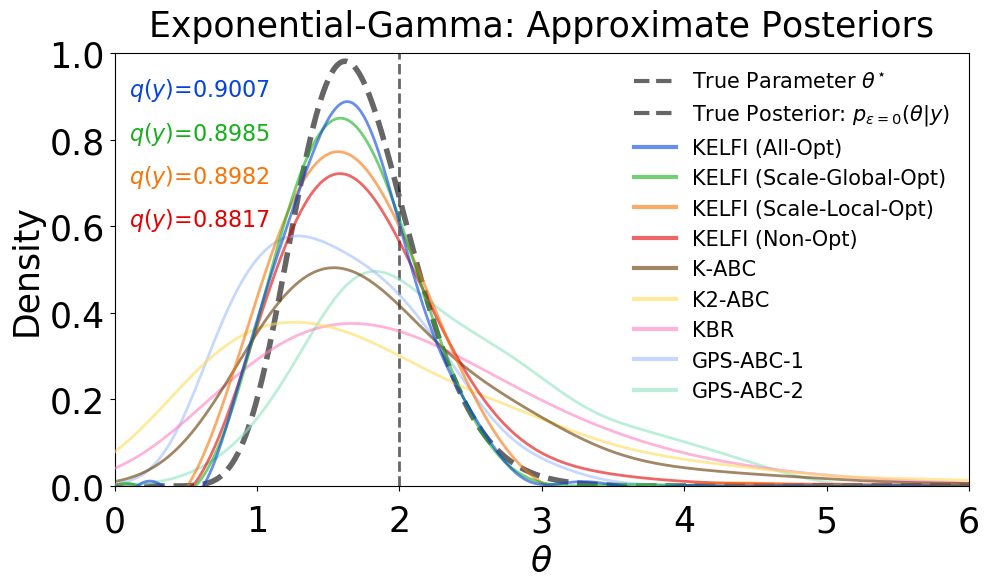

In [74]:
def temp_plot():

    # Setup
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))
    
    # Computations
    t = t_query.ravel()
    
    # Plot: True Posterior
    ax.axvline(theta_true, c='k', linestyle='--', linewidth=2.0, alpha=0.6, label=r'True Parameter $\theta^{\star}$')
    ax.plot(t, posterior_pdf(t, y_data[0]), c='k', linestyle='--', linewidth=4.0, alpha=0.6, label=r'True Posterior: $p_{\epsilon=0}(\theta | y)$')
    
    # Plot: KELFI
    ax.plot(t, kmp_opt_query, c=sns.xkcd_rgb['blue'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=100, label=r'KELFI (All-Opt)')
    ax.plot(t, kmp_global_query, c=sns.xkcd_rgb['green'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=99, label=r'KELFI (Scale-Global-Opt)')
    ax.plot(t, kmp_local_query, c=sns.xkcd_rgb['orange'], linewidth=2.0, linestyle='-', zorder=98, alpha=0.6, label=r'KELFI (Scale-Local-Opt)')
    ax.plot(t, kmp_arb_query, c=sns.xkcd_rgb['red'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=97, label=r'KELFI (Non-Opt)')
    
    # Plot: Other Kernel Approaches
    ax.plot(t, k1_abc_posterior_density_query, c=sns.xkcd_rgb['brown'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=96, label='K-ABC')
    ax.plot(t, k2_abc_posterior_density_query, c=sns.xkcd_rgb['light gold'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=95, label='K2-ABC')
    ax.plot(t, kbr_1_abc_posterior_density_query, c=sns.xkcd_rgb['pink'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=94, label='KBR')
    ls = 0.25
    ax.plot(t, kde(gps_abc_posterior_samples_1, t_query, ls), c=sns.xkcd_rgb['pastel blue'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=93, label='GPS-ABC-1')
    ax.plot(t, kde(gps_abc_posterior_samples_2, t_query, ls), c=sns.xkcd_rgb['light teal'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=92, label='GPS-ABC-2')
    
    # Annotations
    ax.text(0.1, 0.9, r'$q(y)$=%.4f' % mkml_opt, color=sns.xkcd_rgb['blue'], fontsize=16)
    ax.text(0.1, 0.8, r'$q(y)$=%.4f' % mkml_global, color=sns.xkcd_rgb['green'], fontsize=16)
    ax.text(0.1, 0.7, r'$q(y)$=%.4f' % mkml_local, color=sns.xkcd_rgb['orange'], fontsize=16)
    ax.text(0.1, 0.6, r'$q(y)$=%.4f' % mkml_arb, color=sns.xkcd_rgb['red'], fontsize=16)
 
    # Aesthetics
    ax.set_xlim((t_min, 6))
    ax.set_ylim((0, 1))
    ax.set_title(r'Exponential-Gamma: Approximate Posteriors', fontsize=25, y=1.02)
    ax.set_xlabel(r'$\theta$', fontsize=25)
    ax.set_ylabel(r'Density', fontsize=25)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(25)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(25)
    plt.xticks(y=-0.02)
    plt.tight_layout()
    leg = ax.legend(fontsize=15, loc='upper right', bbox_to_anchor=(1, 1), frameon=False)
    for legobj in leg.legendHandles:
        legobj.set_linewidth(3.0)
    fig.savefig('exponential_gamma_approximate_posteriors.pdf', format='pdf', dpi=1000)
    
temp_plot()

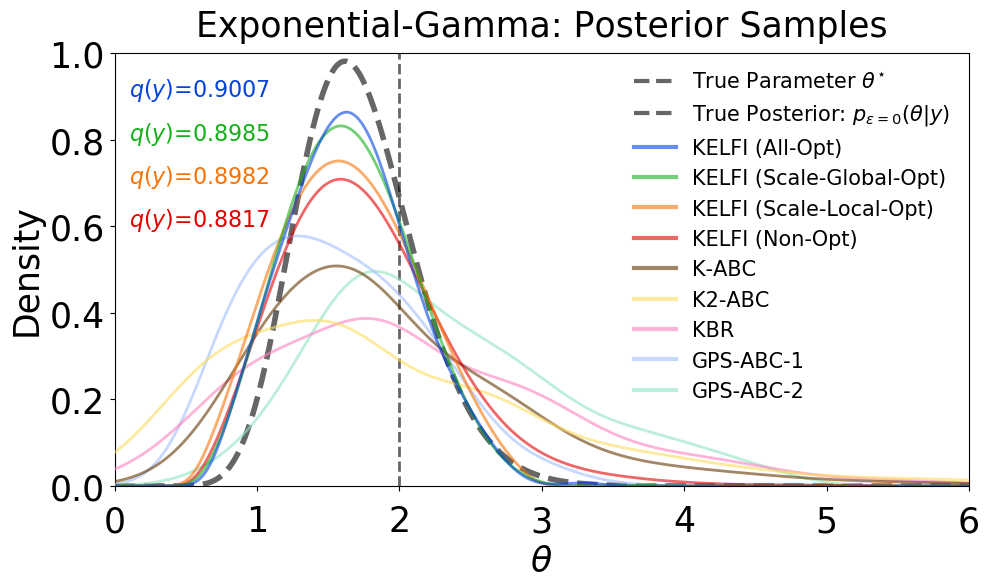

In [75]:
def temp_plot():

    # Setup
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))
    
    # Computations
    t = t_query.ravel()
    
    # Plot: True Posterior
    ax.axvline(theta_true, c='k', linestyle='--', linewidth=2.0, alpha=0.6, label=r'True Parameter $\theta^{\star}$')
    ax.plot(t, posterior_pdf(t, y_data[0]), c='k', linestyle='--', linewidth=4.0, alpha=0.6, label=r'True Posterior: $p_{\epsilon=0}(\theta | y)$')
    
    # Plot: KELFI
    ax.plot(t, kde(t_kmpe_opt, t_query, beta_query), c=sns.xkcd_rgb['blue'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=100, label=r'KELFI (All-Opt)')
    ax.plot(t, kde(t_kmpe_global, t_query, beta_query), c=sns.xkcd_rgb['green'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=99, label=r'KELFI (Scale-Global-Opt)')
    ax.plot(t, kde(t_kmpe_local, t_query, beta_query), c=sns.xkcd_rgb['orange'], linewidth=2.0, linestyle='-', zorder=98, alpha=0.6, label=r'KELFI (Scale-Local-Opt)')
    ax.plot(t, kde(t_kmpe_arb, t_query, beta_query), c=sns.xkcd_rgb['red'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=97, label=r'KELFI (Non-Opt)')
    
    # Plot: Other Kernel Approaches
    ax.plot(t, kde(k1_abc_posterior_samples, t_query, ls_t_vis), c=sns.xkcd_rgb['brown'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=96, label='K-ABC')
    ax.plot(t, kde(k2_abc_posterior_samples, t_query, ls_t_vis), c=sns.xkcd_rgb['light gold'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=96, label='K2-ABC')
    ax.plot(t, kde(kbr_1_abc_samples, t_query, ls_t_vis), c=sns.xkcd_rgb['pink'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=94, label='KBR')
    ls = 0.25
    ax.plot(t, kde(gps_abc_posterior_samples_1, t_query, ls), c=sns.xkcd_rgb['pastel blue'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=93, label='GPS-ABC-1')
    ax.plot(t, kde(gps_abc_posterior_samples_2, t_query, ls), c=sns.xkcd_rgb['light teal'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=92, label='GPS-ABC-2')
    
    # Annotations
    ax.text(0.1, 0.9, r'$q(y)$=%.4f' % mkml_opt, color=sns.xkcd_rgb['blue'], fontsize=16)
    ax.text(0.1, 0.8, r'$q(y)$=%.4f' % mkml_global, color=sns.xkcd_rgb['green'], fontsize=16)
    ax.text(0.1, 0.7, r'$q(y)$=%.4f' % mkml_local, color=sns.xkcd_rgb['orange'], fontsize=16)
    ax.text(0.1, 0.6, r'$q(y)$=%.4f' % mkml_arb, color=sns.xkcd_rgb['red'], fontsize=16)
 
    # Aesthetics
    ax.set_xlim((t_min, 6))
    ax.set_ylim((0, 1))
    ax.set_title(r'Exponential-Gamma: Posterior Samples', fontsize=25, y=1.02)
    ax.set_xlabel(r'$\theta$', fontsize=25)
    ax.set_ylabel(r'Density', fontsize=25)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(25) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(25)
    plt.xticks(y=-0.02)
    plt.tight_layout()
    leg = ax.legend(fontsize=15, loc='upper right', bbox_to_anchor=(1, 1), frameon=False)
    for legobj in leg.legendHandles:
        legobj.set_linewidth(3.0)
    fig.savefig('exponential_gamma_approximate_posterior_embedding_sampling.pdf', format='pdf', dpi=1000)
    
temp_plot()

Captions: Comparisons of KELFI with other kernel-based likelihood-free inference approaches. Note that GPS-ABC-1 and GPS-ABC-2 used 130 and 197 simulations respectively, more than the 100 simulations other kernel approaches used.

The first plot shows their most direct density surrogates. KELFI uses KMP. K-ABC, K2-ABC, and KBR uses weighted samples, with weights that are not necessarily positive.

The second plot shows the posterior using their kernel herded samples.

GPS-ABC stays the same for both plots since they produce posterior samples directly.

# Package Versions

    >> pip freeze
    absl-py==0.1.9
    astor==0.6.2
    autograd==1.2
    bleach==1.5.0
    boto3==1.7.10
    botocore==1.10.10
    cachetools==2.0.1
    certifi==2018.4.16
    chardet==3.0.4
    colorama==0.3.9
    cycler==0.10.0
    decorator==4.2.1
    dill==0.2.7.1
    docutils==0.14
    entrypoints==0.2.3
    enum34==1.1.6
    et-xmlfile==1.0.1
    future==0.16.0
    gapic-google-cloud-datastore-v1==0.15.3
    gapic-google-cloud-error-reporting-v1beta1==0.15.3
    gapic-google-cloud-logging-v2==0.91.3
    gast==0.2.0
    ghalton==0.6.1
    google-api-core==0.1.4
    google-auth==1.4.1
    google-cloud==0.32.0
    google-cloud-bigquery==0.28.0
    google-cloud-bigquery-datatransfer==0.1.1
    google-cloud-bigtable==0.28.1
    google-cloud-container==0.1.1
    google-cloud-core==0.28.1
    google-cloud-dataproc==0.1.0
    google-cloud-datastore==1.4.0
    google-cloud-dns==0.28.0
    google-cloud-error-reporting==0.28.0
    google-cloud-firestore==0.28.0
    google-cloud-language==1.0.1
    google-cloud-logging==1.4.0
    google-cloud-monitoring==0.28.1
    google-cloud-pubsub==0.30.1
    google-cloud-resource-manager==0.28.1
    google-cloud-runtimeconfig==0.28.1
    google-cloud-spanner==0.29.0
    google-cloud-speech==0.30.0
    google-cloud-storage==1.6.0
    google-cloud-trace==0.17.0
    google-cloud-translate==1.3.1
    google-cloud-videointelligence==1.0.1
    google-cloud-vision==0.29.0
    google-gax==0.15.16
    google-resumable-media==0.3.1
    googleapis-common-protos==1.5.3
    graphviz==0.9
    grpc-google-iam-v1==0.11.4
    grpcio==1.11.0
    html5lib==0.9999999
    httplib2==0.11.3
    idna==2.6
    imageio==2.4.1
    ipykernel==4.8.0
    ipython==6.2.1
    ipython-genutils==0.2.0
    ipywidgets==7.1.0
    jdcal==1.3
    jedi==0.11.1
    Jinja2==2.10
    jmespath==0.9.3
    jsonschema==2.6.0
    jupyter==1.0.0
    jupyter-client==5.2.1
    jupyter-console==5.2.0
    jupyter-core==4.4.0
    kiwisolver==1.0.1
    Markdown==2.6.11
    MarkupSafe==1.0
    matplotlib==2.2.2
    mistune==0.8.3
    mrjob==0.6.2
    nbconvert==5.3.1
    nbformat==4.4.0
    nltk==3.2.5
    notebook==5.3.1
    numpy==1.14.2
    oauth2client==3.0.0
    openpyxl==2.5.0
    pandas==0.22.0
    pandocfilters==1.4.2
    parso==0.1.1
    patsy==0.5.0
    pickleshare==0.7.4
    Pillow==5.1.0
    ply==3.8
    prompt-toolkit==1.0.15
    proto-google-cloud-datastore-v1==0.90.4
    proto-google-cloud-error-reporting-v1beta1==0.15.3
    proto-google-cloud-logging-v2==0.91.3
    protobuf==3.5.1
    psutil==5.4.5
    pyasn1==0.4.2
    pyasn1-modules==0.2.1
    Pygments==2.2.0
    pyparsing==2.2.0
    pyreadline==2.1
    python-dateutil==2.6.1
    pytz==2017.3
    pywinpty==0.5.1
    PyYAML==3.12
    pyzmq==16.0.3
    qtconsole==4.3.1
    requests==2.18.4
    rsa==3.4.2
    s3transfer==0.1.13
    scikit-learn==0.19.1
    scipy==1.0.1
    seaborn==0.8.1
    Send2Trash==1.4.2
    simplegeneric==0.8.1
    six==1.11.0
    sklearn==0.0
    statsmodels==0.8.0
    style==1.1.0
    tensorflow-gpu==1.5.0
    tensorflow-tensorboard==1.5.1
    termcolor==1.1.0
    terminado==0.8.1
    testpath==0.3.1
    tornado==4.5.3
    traitlets==4.3.2
    update==0.0.1
    urllib3==1.22
    wcwidth==0.1.7
    Werkzeug==0.14.1
    widgetsnbextension==3.1.0
    wordcloud==1.4.1
    xlrd==1.1.0